Pancreas: Run64_Pankreas_ROI6, Run64_Pankreas_ROI8, Run64_Pankreas_ROI10, Run64_Pankreas_ROI12, Run64_Pankreas_ROI14, Run64_Pankreas_ROI15, Run64_Pankreas_ROI19, Run64_Pankreas_ROI22

In [1]:
from anndata import AnnData
import anndata as ad
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import seaborn as sns
from numpy.random import default_rng
import matplotlib.pyplot as plt
from scipy.stats import zscore
#from matplotlib.pyplot import figure

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7
squidpy==1.2.2


# Settings

In [2]:
sample = 'ROI10'

In [3]:
# save results in:
import os
# Make a single directory
if not os.path.exists('results_subcluster_' + sample):
    os.mkdir('results_subcluster_' + sample)

In [4]:
# figure & saving settings
sc.settings.set_figure_params(dpi=220, fontsize=12, dpi_save=700, figsize=(10,10))
sc.settings.figdir = 'results_subcluster_' + sample

# Read in data

In [5]:
adata = sc.read_h5ad('data/' + sample + '.h5ad')
adata

AnnData object with n_obs × n_vars = 17249 × 38
    obs: 'leiden'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

# Assign immune/ non immune cells

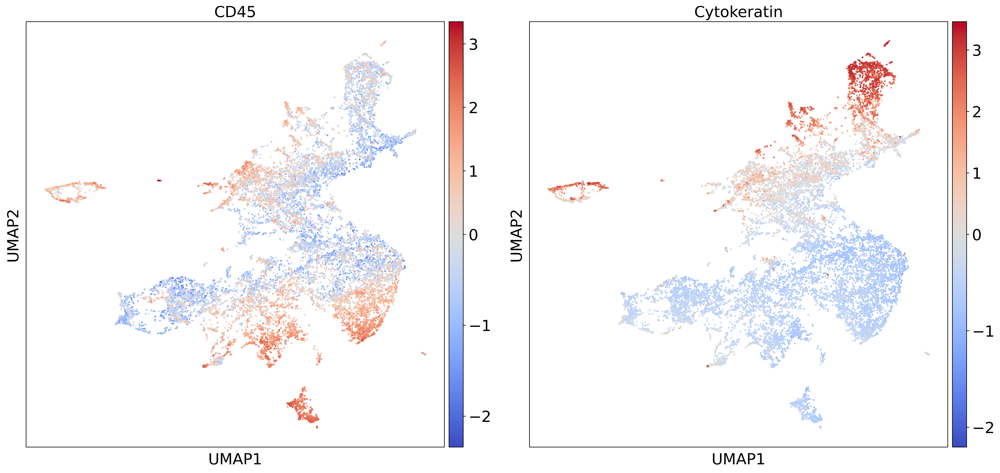

In [6]:
sc.settings.set_figure_params(dpi=220, fontsize=20, dpi_save=700, figsize=(10,10))
sc.pl.umap(adata, color=['CD45', 'Cytokeratin'], s=20, use_raw=False,  legend_fontsize=12, color_map='coolwarm', vcenter=0)

In [7]:
immune_type= {
'0' : 'non',
'1' : 'non',
'2' : 'Immune cells', 
'3' : 'Immune cells', 
'4' : 'non',
'5' : 'Immune cells', 
'6' : 'Immune cells', 
'7' : 'Immune cells',
'8' : 'non', 
'9' : 'non', 
'10' : 'non', 
'11' : 'non',
'12' : 'non',
'13' : 'Immune cells', 
'14' : 'non', 
'15' : 'non', 
'16' : 'non', 
'17' : 'non', 
'18' : 'non',
'19' : 'non',
'20' : 'non',
'21' :'non',
'22' : 'Immune cells',
'23' : 'Immune cells',
'24' : 'non',
'25' : 'non', 
'26' : 'non', 
'27' : 'non',
'28' : 'non', 
'29' : 'non', 
'30' : 'non',
'31' : 'Immune cells', 
'32' : 'Immune cells', 
'33' : 'Immune cells', 
'34' : 'non',
'35' : 'non',
'36' : 'Immune cells', 
'37' : 'Immune cells', 
'38' : 'non',
'39' : 'non', 
'40' : 'Immune cells', 
}
adata.obs['immune_annotation'] = (adata.obs['leiden'].map(immune_type).astype('category'))

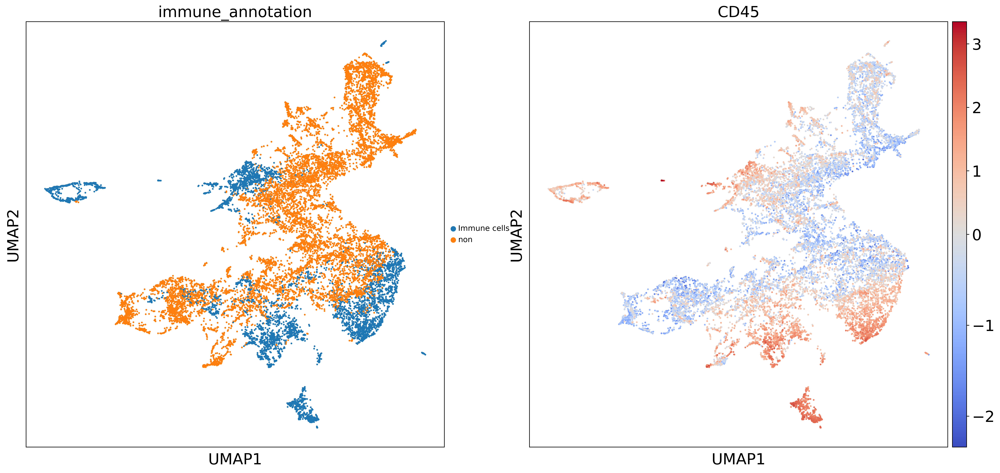

In [8]:
sc.pl.umap(adata, color=['immune_annotation', 'CD45'], s=20, use_raw=False,  legend_fontsize=10, color_map='coolwarm', vcenter=0)

In [9]:
Tcells_type= {
'0' : 'non',
'1' : 'Tumour cells',
'2' : 'non',
'3' : 'non',
'4' : 'non',
'5' : 'non',
'6' : 'non',
'7' : 'non',
'8' : 'Tumour cells', 
'9' : 'non', 
'10' : 'non', 
'11' : 'non',
'12' : 'non',
'13' : 'non',
'14' : 'non', 
'15' : 'Tumour cells?', 
'16' : 'non', 
'17' : 'non', 
'18' : 'non',
'19' : 'non',
'20' : 'non',
'21' : 'non',
'22' : 'non',
'23' : 'non',
'24' : 'non',
'25' : 'Tumour cells', 
'26' : 'non', 
'27' : 'non',
'28' : 'non', 
'29' : 'non', 
'30' : 'non',
'31' : 'non',
'32' : 'non',
'33' : 'non',
'34' : 'non',
'35' : 'non',
'36' : 'non',
'37' : 'Tumour cells',
'38' : 'Tumour cells',
'39' : 'Tumour cells', 
'40' : 'non',
}
adata.obs['Tcells_annotation'] = (adata.obs['leiden'].map(Tcells_type).astype('category'))

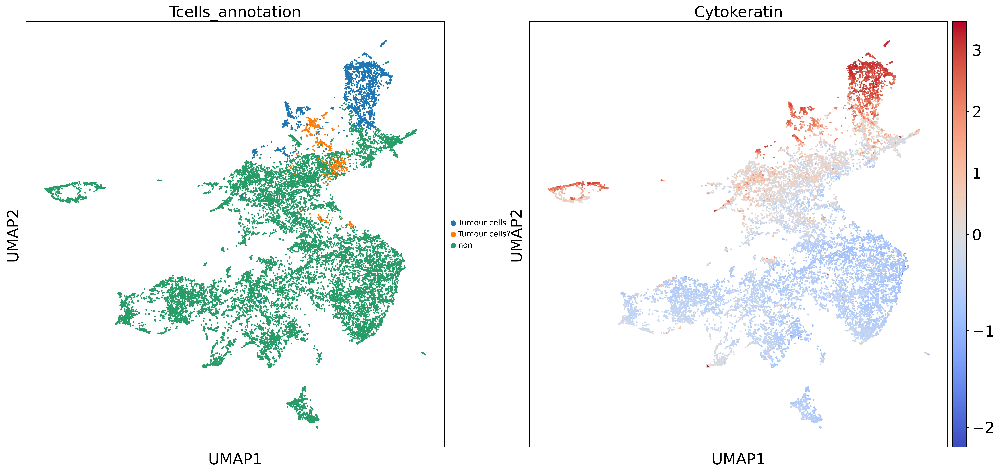

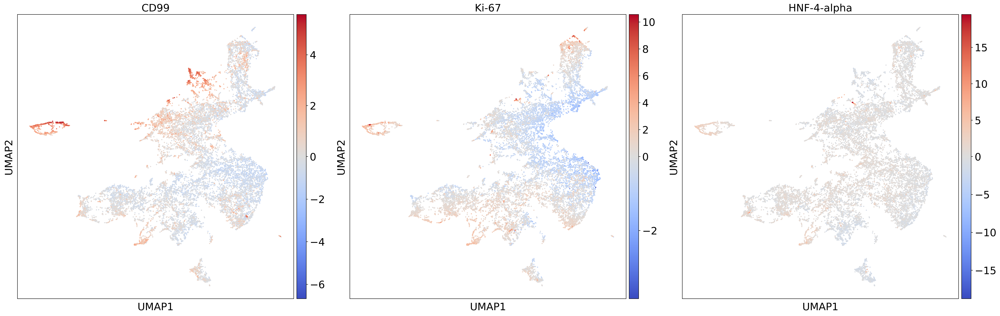

In [10]:
sc.pl.umap(adata, color=['Tcells_annotation', 'Cytokeratin'], s=20, use_raw=False,  legend_fontsize=10, color_map='coolwarm', vcenter=0)
sc.pl.umap(adata, color=['CD99', 'Ki-67', 'HNF-4-alpha'], s=20, use_raw=False,  legend_fontsize=10, color_map='coolwarm', vcenter=0)

# First annotation of original Leiden

In [11]:
first_annotation = {
'0' : '0', 
'1' : 'Tumour cells', 
'2' : '2', 
'3' : 'T cells (act/reg)', 
'4' : '?',  
'5' : 'Dendritic cells', 
'6' : 'B cells', 
'7' : 'T cells (act/reg)', 
'8' : 'Tumour cells', 
'9' : 'CAF', 
'10' : 'Collagen',  
'11' : 'Collagen',  
'12' : 'Collagen', 
'13' : 'Dendritic cells', 
'14' : 'Collagen', 
'15' : 'Collagen/ Tumour cells', 
'16' : 'Fibroblasts', 
'17' : 'Collagen', 
'18' : 'Fibroblasts', 
'19' : 'Fibroblasts', 
'20' : 'Collagen', 
'21' : 'Granulocyte', 
'22' : 'T cells (act/reg)', 
'23' : '23', 
'24' : 'Collagen', 
'25' : 'Tumour cells', 
'26' : 'Lymphatic Vessels ', 
'27' : 'Collagen', 
'28' : 'Collagen', 
'29' : 'Granulocyte/ Mast cells', 
'30' : 'Granulocyte', 
'31' : 'Tumour cells/ NK cells ', 
'32' : 'Plasma cells', 
'33' : 'Fibroblasts', 
'34' : 'Fibroblasts/ M2', 
'35' : 'Fibroblasts', 
'36' : 'Fibroblasts', 
'37' : 'Tumour cells', 
'38' : 'Tumour cells', 
'39' : 'Tumour cells', 
'40' : 'Activated B cells', 

}
adata.obs['first_annotation'] = (adata.obs['leiden'].map(first_annotation).astype('category'))

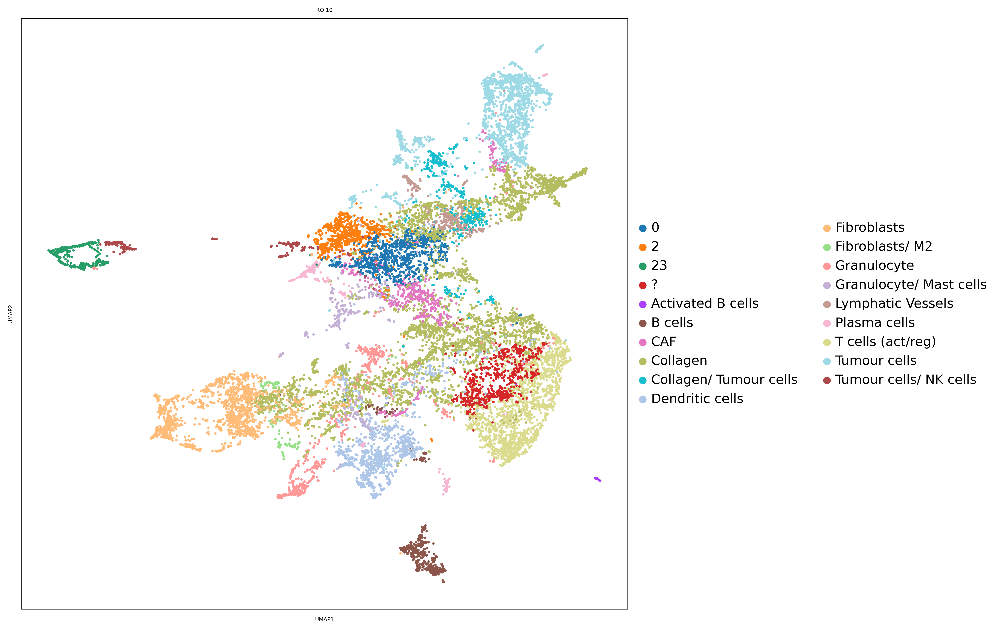

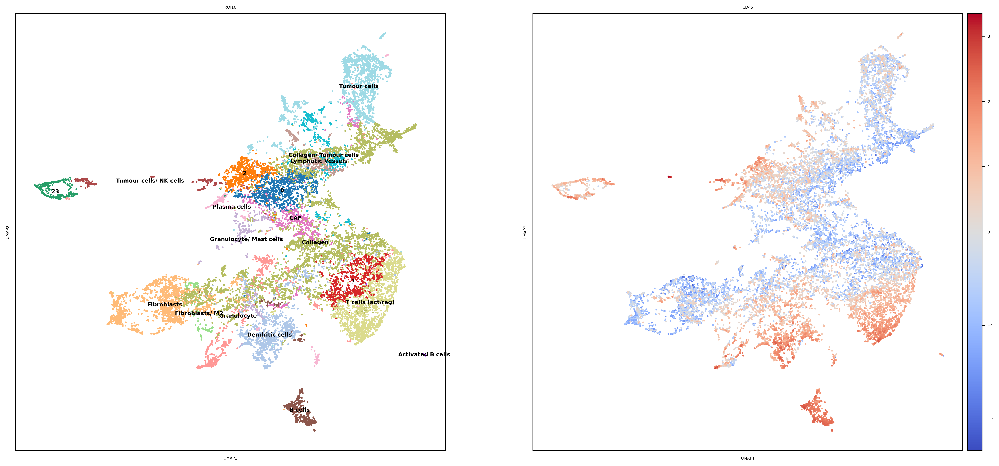

In [12]:
sc.settings.set_figure_params(dpi=220, fontsize=5, dpi_save=700, figsize=(10,10))
sc.pl.umap(adata, color=['first_annotation'], s=20, use_raw=False,  legend_fontsize=12, title = sample, color_map='coolwarm', vcenter=0)
sc.pl.umap(adata, color=['first_annotation', 'CD45'], s=20, use_raw=False, legend_fontsize=7,  title = sample, legend_loc='on data', color_map='coolwarm', vcenter=0)

# Choose cluster

In [13]:
# get IDs for every Cluster
def getCluster(numCluster):
    id_of_cluster = [key for key, val in  adata.obs['leiden'].items() if val == str(numCluster)] # get all IDs of one cluster
    clusterID = adata.to_df().loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
    return clusterID

In [14]:
cluster0 = getCluster(0)
cluster1 = getCluster(1)
cluster2 = getCluster(2)
cluster3 = getCluster(3)
cluster4 = getCluster(4)
cluster5 = getCluster(5)
cluster6 = getCluster(6)
cluster7 = getCluster(7)
cluster8 = getCluster(8)
cluster9 = getCluster(9)
cluster10 = getCluster(10)
cluster11 = getCluster(11)
cluster12 = getCluster(12)
cluster13 = getCluster(13)
cluster14 = getCluster(14)
cluster15 = getCluster(15)
cluster16 = getCluster(16)
cluster17 = getCluster(17)
cluster18 = getCluster(18)
cluster19 = getCluster(19)
cluster20 = getCluster(20)
cluster21 = getCluster(21)
cluster22 = getCluster(22)
cluster23 = getCluster(23)
cluster24 = getCluster(24)
cluster25 = getCluster(25)
cluster26 = getCluster(26)
cluster27 = getCluster(27)
cluster28 = getCluster(28)
cluster29 = getCluster(29)
cluster30 = getCluster(30)
cluster31 = getCluster(31)
cluster32 = getCluster(32)
cluster33 = getCluster(33)
cluster34 = getCluster(34)
cluster35 = getCluster(35)
cluster36 = getCluster(36)
cluster37 = getCluster(37)
cluster38 = getCluster(38)
cluster39 = getCluster(39)
cluster40 = getCluster(40)

In [15]:
# generate AnnData for every Subcluster
cluster0 = AnnData(cluster0)
cluster1 = AnnData(cluster1)
cluster2 = AnnData(cluster2)
cluster3 = AnnData(cluster3)
cluster4 = AnnData(cluster4)
cluster5 = AnnData(cluster5)
cluster6 = AnnData(cluster6)
cluster7 = AnnData(cluster7)
cluster8 = AnnData(cluster8)
cluster9 = AnnData(cluster9)
cluster10 = AnnData(cluster10)
cluster11 = AnnData(cluster11)
cluster12 = AnnData(cluster12)
cluster13 = AnnData(cluster13)
cluster14 = AnnData(cluster14)
cluster15 = AnnData(cluster15)
cluster16 = AnnData(cluster16)
cluster17 = AnnData(cluster17)
cluster18 = AnnData(cluster18)
cluster19 = AnnData(cluster19)
cluster20 = AnnData(cluster20)
cluster21 = AnnData(cluster21)
cluster22 = AnnData(cluster22)
cluster23 = AnnData(cluster23)
cluster24 = AnnData(cluster24)
cluster25 = AnnData(cluster25)
cluster26 = AnnData(cluster26)
cluster27 = AnnData(cluster27)
cluster28 = AnnData(cluster28)
cluster29 = AnnData(cluster29)
cluster30 = AnnData(cluster30)
cluster31 = AnnData(cluster31)
cluster32 = AnnData(cluster32)
cluster33 = AnnData(cluster33)
cluster34 = AnnData(cluster34)
cluster35 = AnnData(cluster35)
cluster36 = AnnData(cluster36)
cluster37 = AnnData(cluster37)
cluster38 = AnnData(cluster38)
cluster39 = AnnData(cluster39)
cluster40 = AnnData(cluster40)

## PCA

In [16]:
# compute PCs for every Subcluster
def pc(data1):
    sc.settings.set_figure_params(dpi=50, fontsize=10,figsize=(8,8))
    sc.tl.pca(data1, svd_solver='arpack')
    sc.pl.pca_variance_ratio(data1, log=False, n_pcs=50)

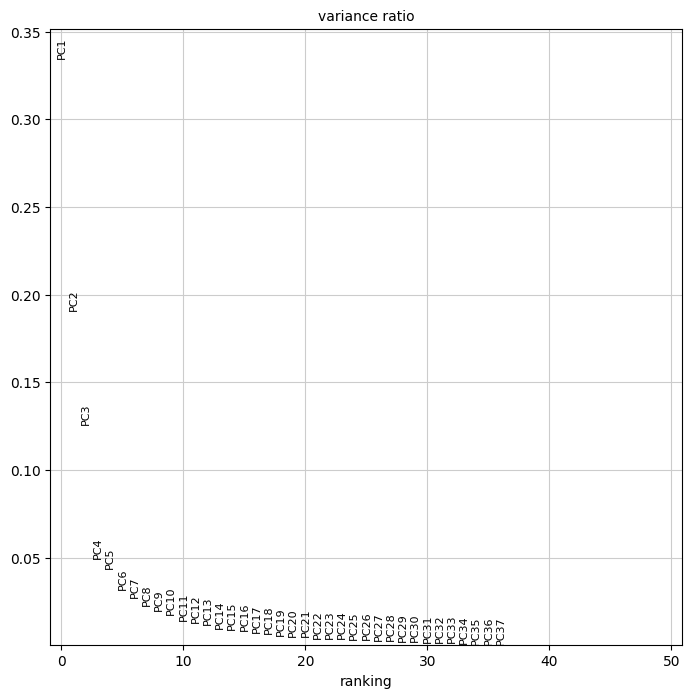

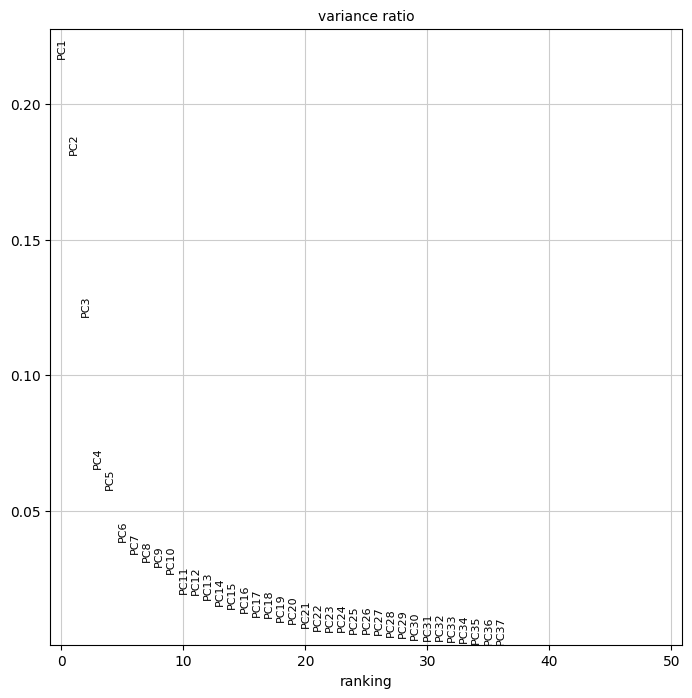

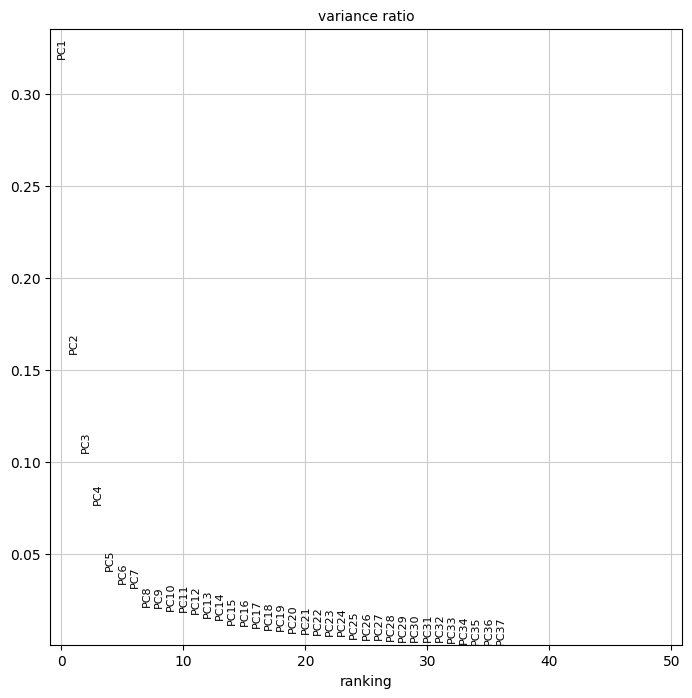

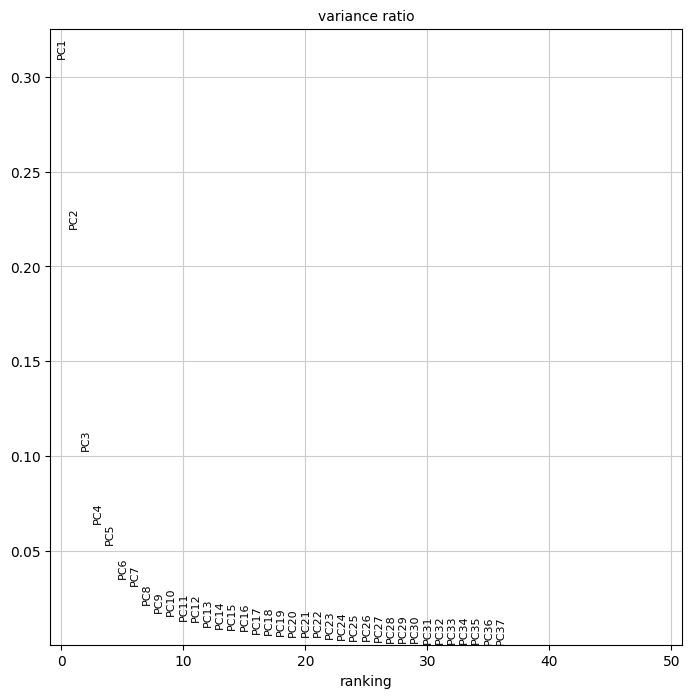

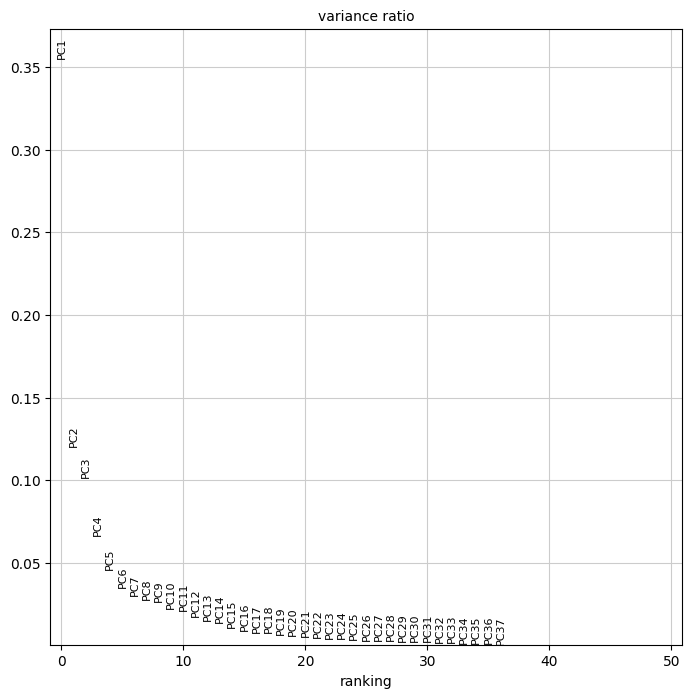

...

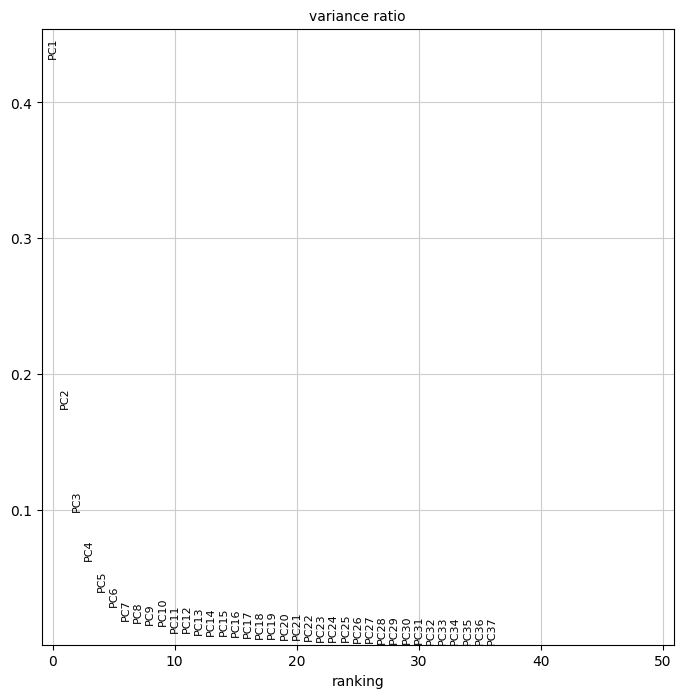

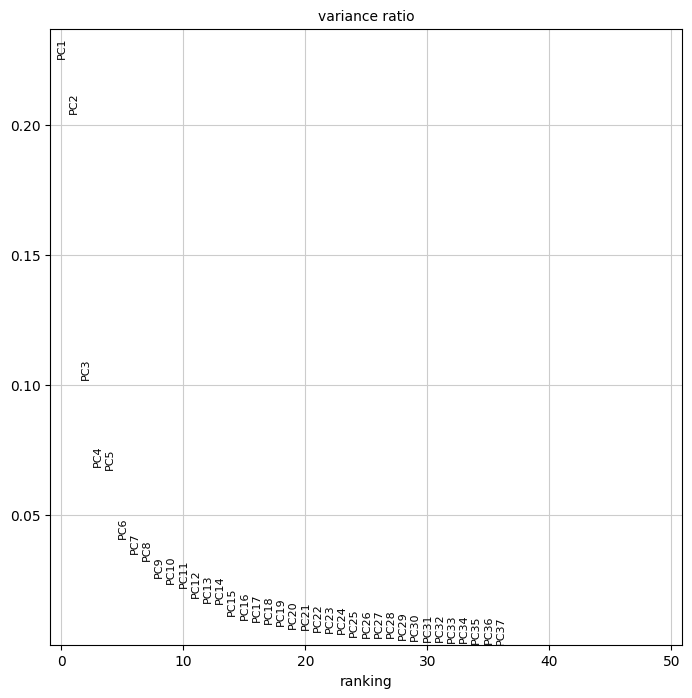

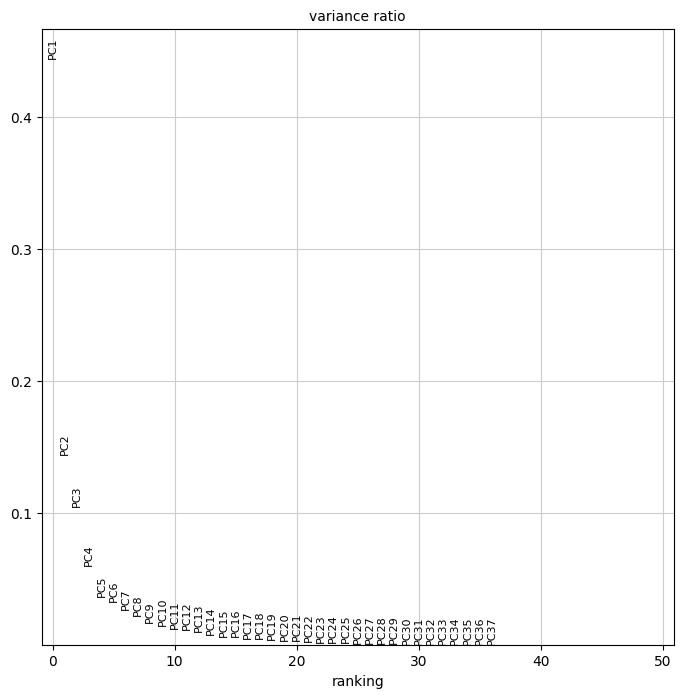

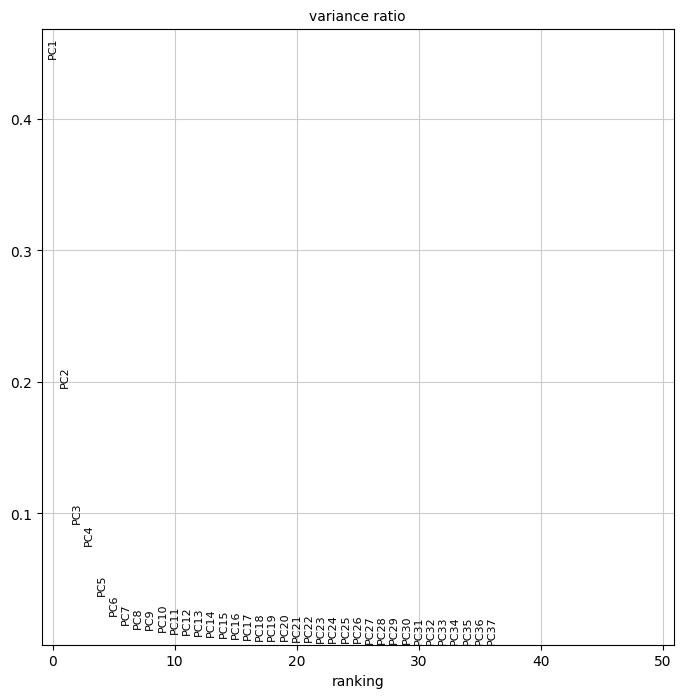

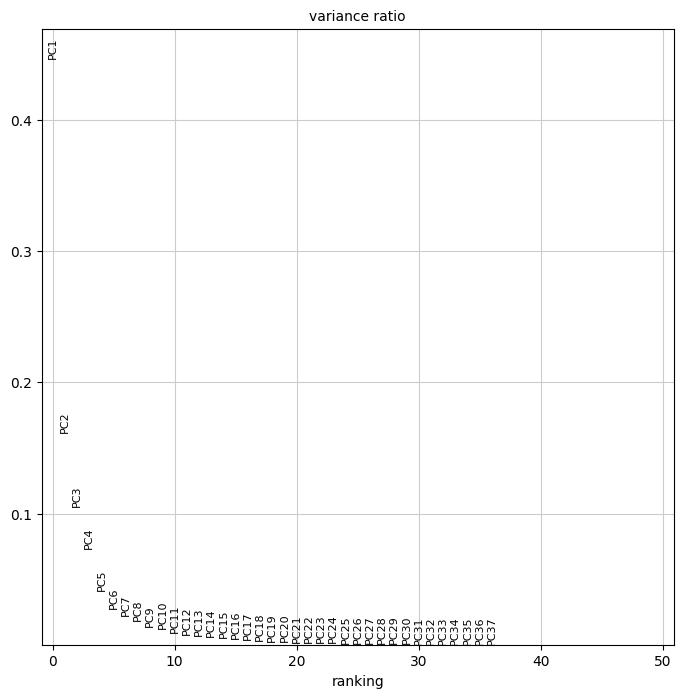

In [17]:
pc(cluster0) 
#pc(cluster1) 
pc(cluster2) 
pc(cluster3)
pc(cluster4)
pc(cluster5) 
pc(cluster6)
pc(cluster7)
#pc(cluster8)
pc(cluster9)
#pc(cluster10) 
#pc(cluster11)
#pc(cluster12) 
#pc(cluster13)
#pc(cluster14) 
#pc(cluster15)
#pc(cluster16)
#pc(cluster17)
#pc(cluster18)
#pc(cluster20)
pc(cluster21)
pc(cluster22) 
pc(cluster23) 
#pc(cluster25)
#pc(cluster28)
#pc(cluster30)
pc(cluster31)
pc(cluster32)

In [18]:
pc0 = 4
#pc1 = 4
pc2 = 6
pc3 = 5
pc4 = 5
pc5 = 5
pc6 = 5
pc7 = 6
pc8 = 3
pc9 = 5
pc10 = 3
pc11 = 3
pc12 = 6
pc13 = 6
pc14 = 5
pc15 = 5
pc16 = 4
pc17 = 4
pc18 = 5
pc19 = 6
pc20 = 7
pc21 = 6
pc22= 6
pc23 = 5
pc25 = 5
pc28 = 4
pc30 = 5
pc31 = 5
pc32 = 4

## Generate UMAPs for Subcluster

In [19]:
def umap(data1, pc1, subcluster, res):
    sc.settings.set_figure_params(dpi=100, fontsize=12,figsize=(10,10))
    # Computing the neighborhood graph
    sc.pp.neighbors(data1, n_neighbors=15, n_pcs=pc1)
    sc.tl.umap(data1, random_state=0, min_dist=0.3, spread=0.4) 
    sc.tl.leiden(data1,resolution=res, key_added = "leiden")
    
    
    #plot results
    sc.pl.umap(data1, color ='leiden', s=60, use_raw=False, title = sample + ' Cluster ' + subcluster, save=  sample + '_' + subcluster + '.pdf')

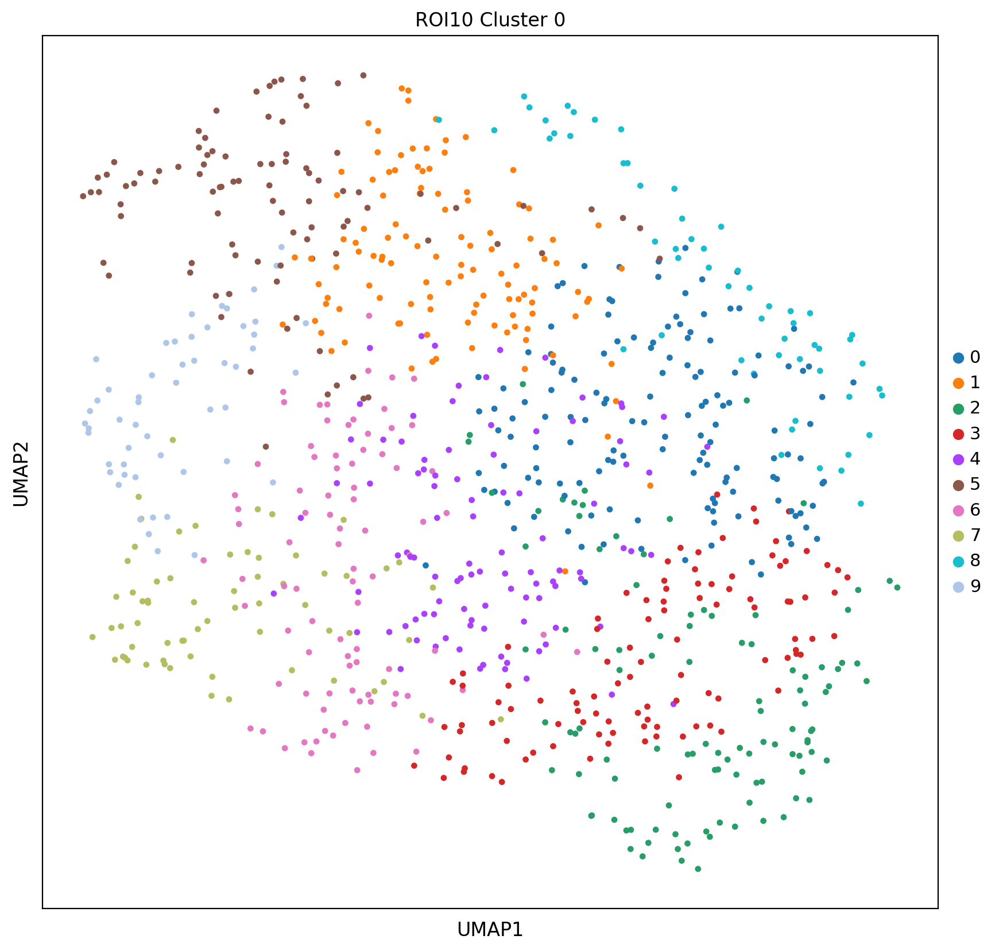

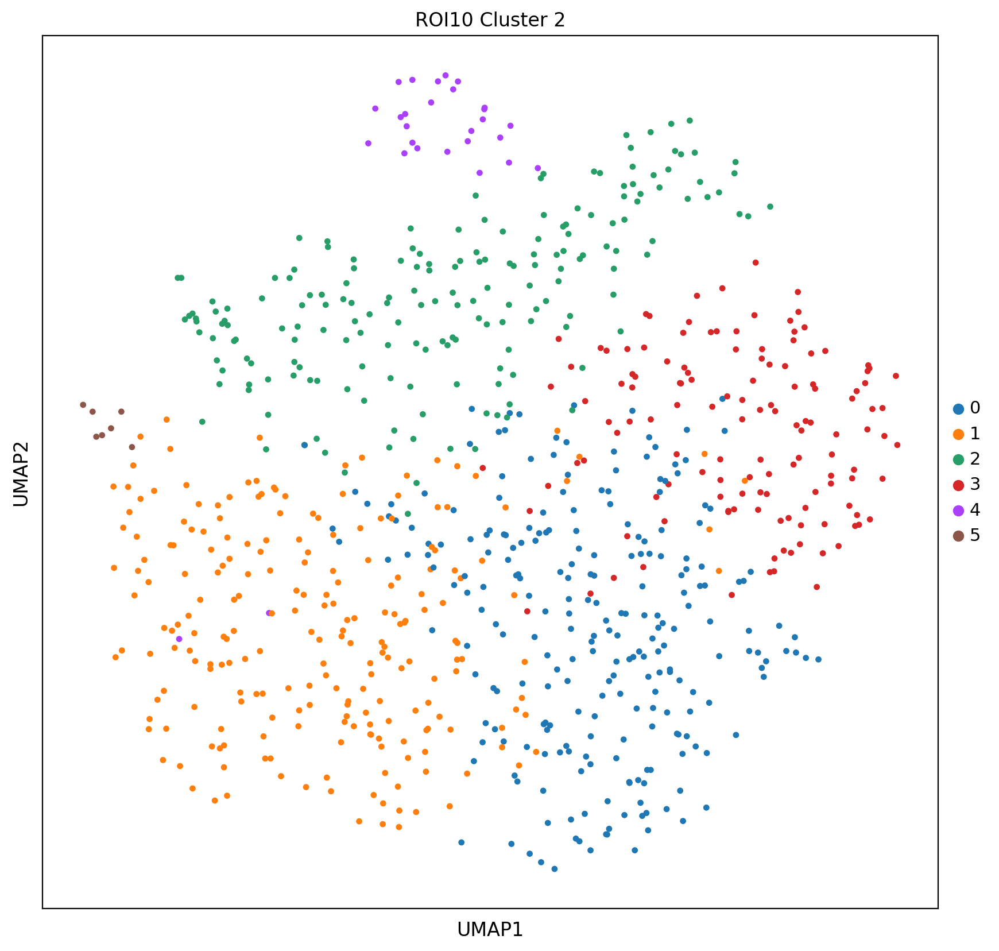

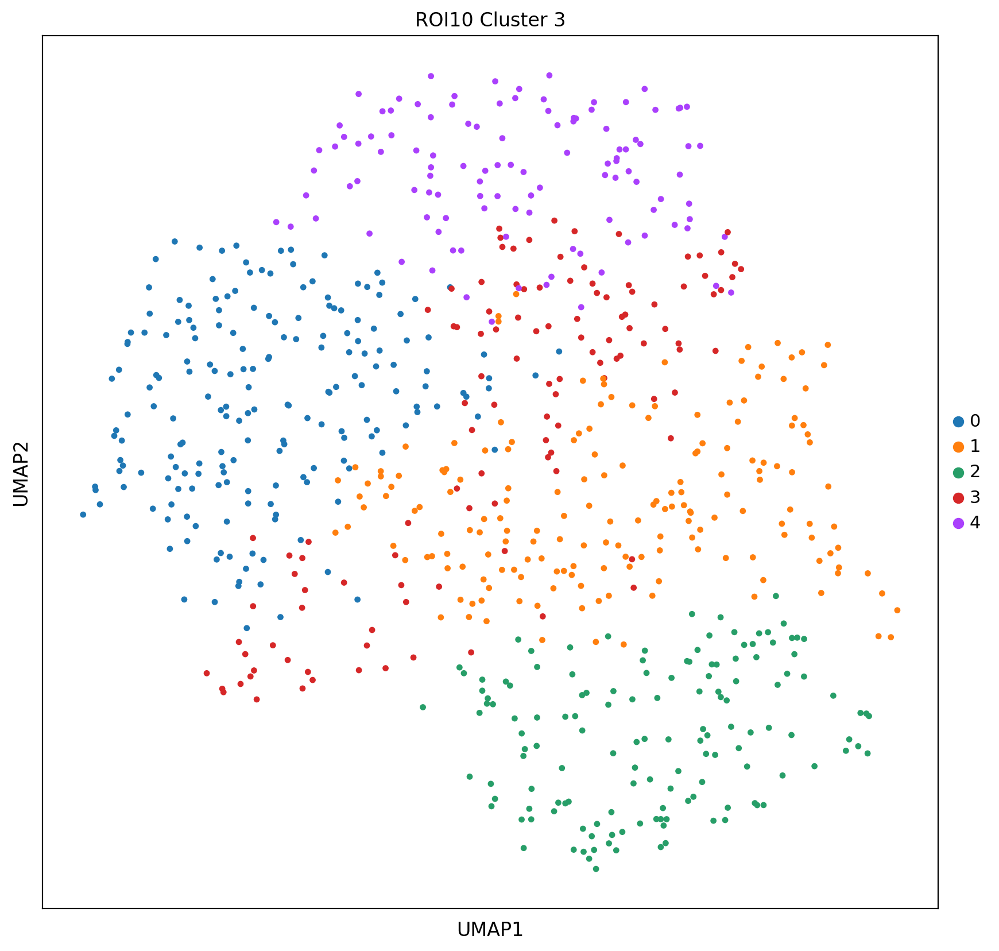

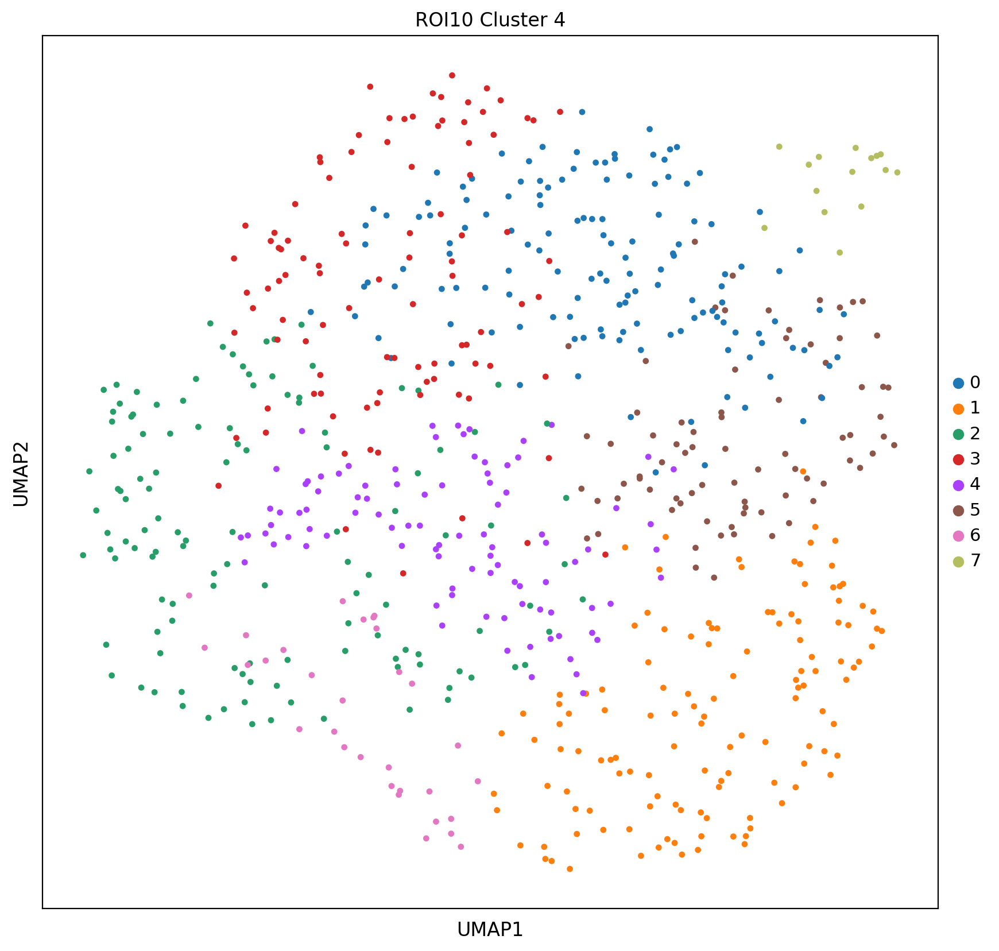

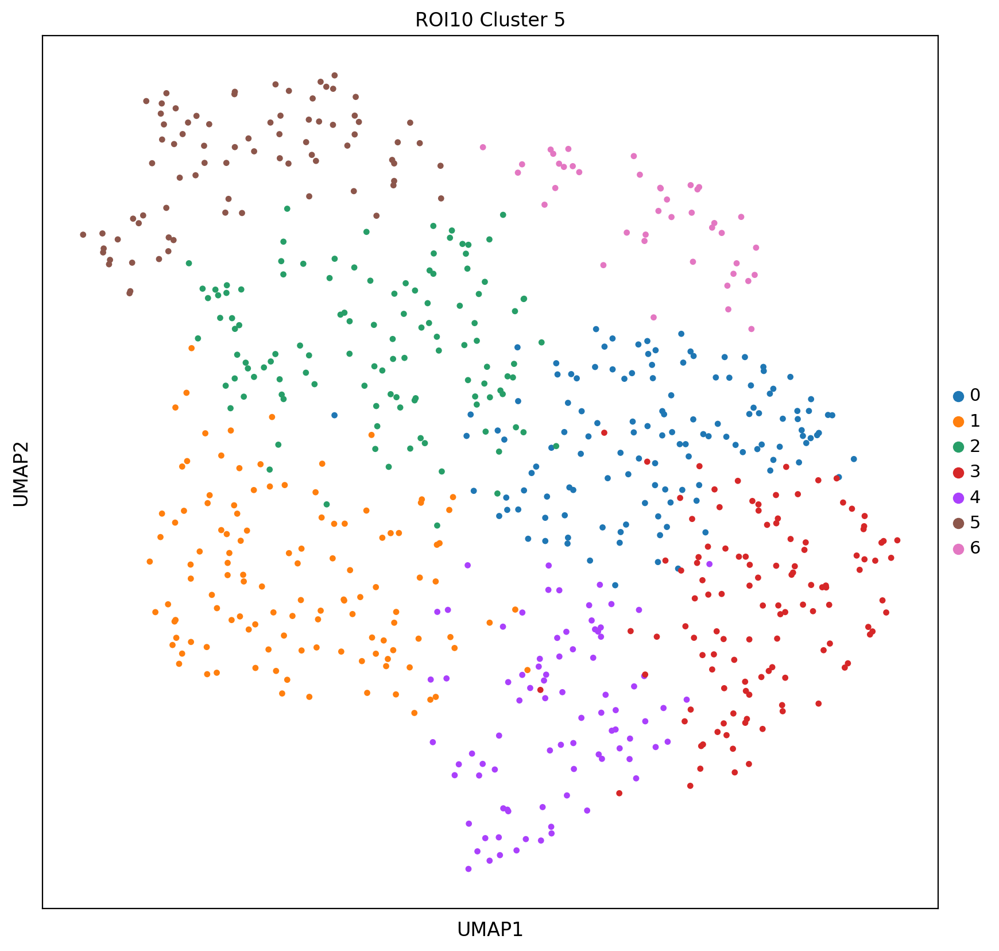

...

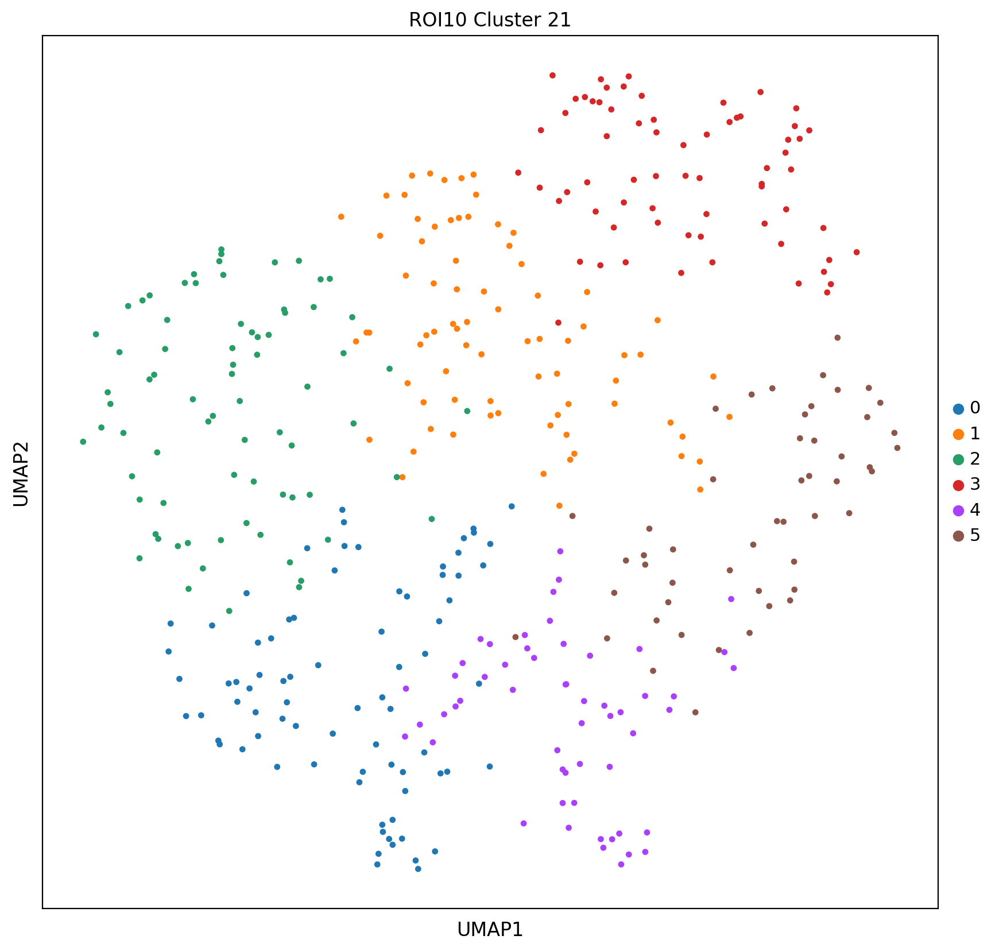

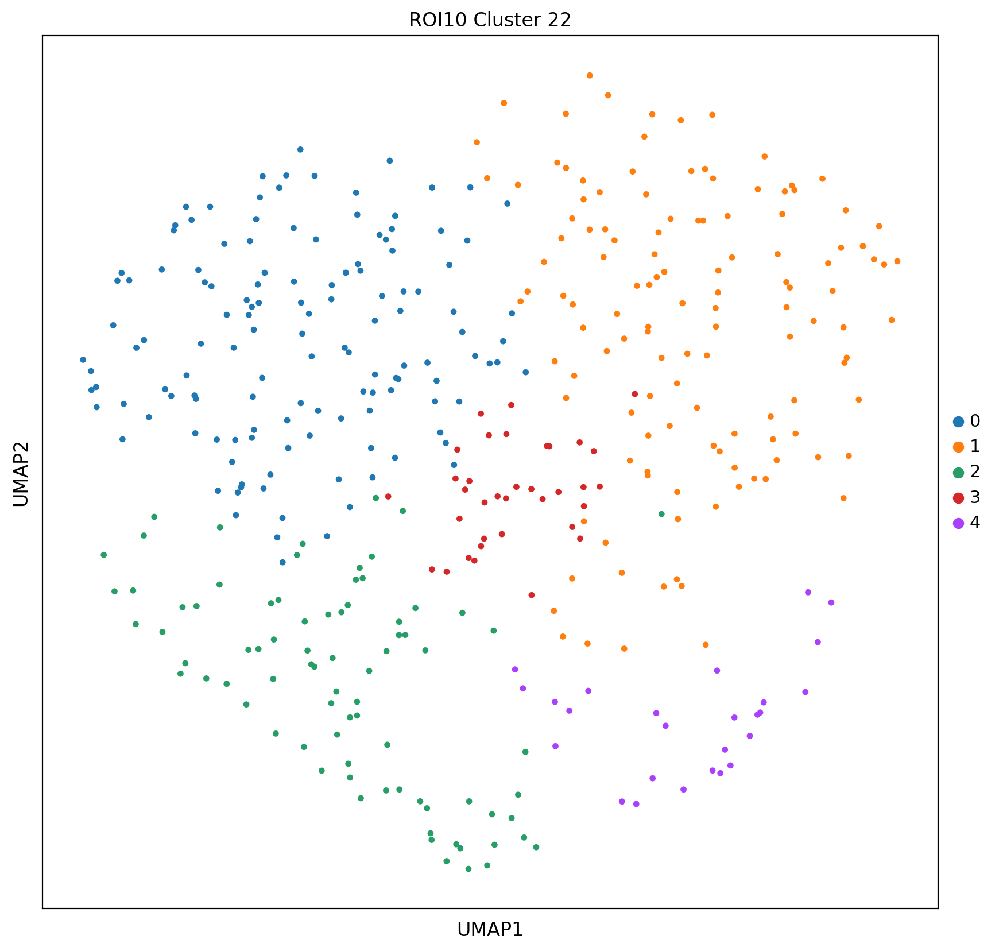

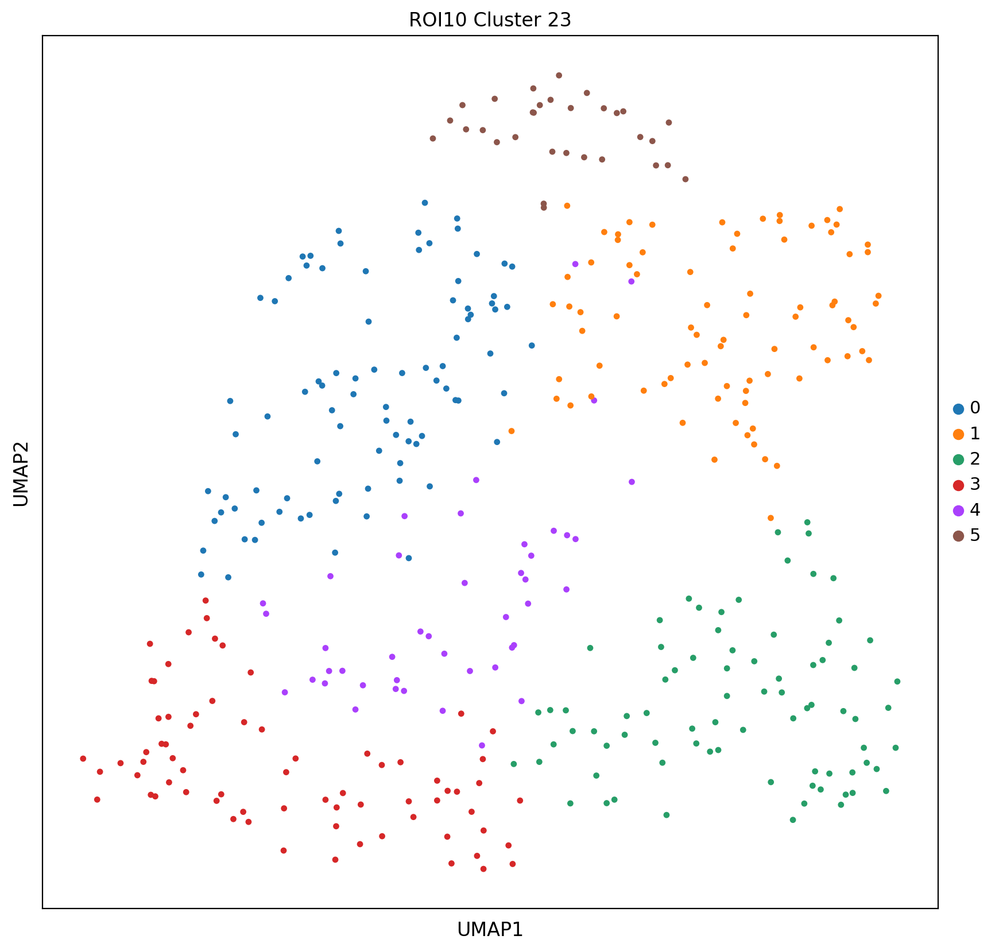

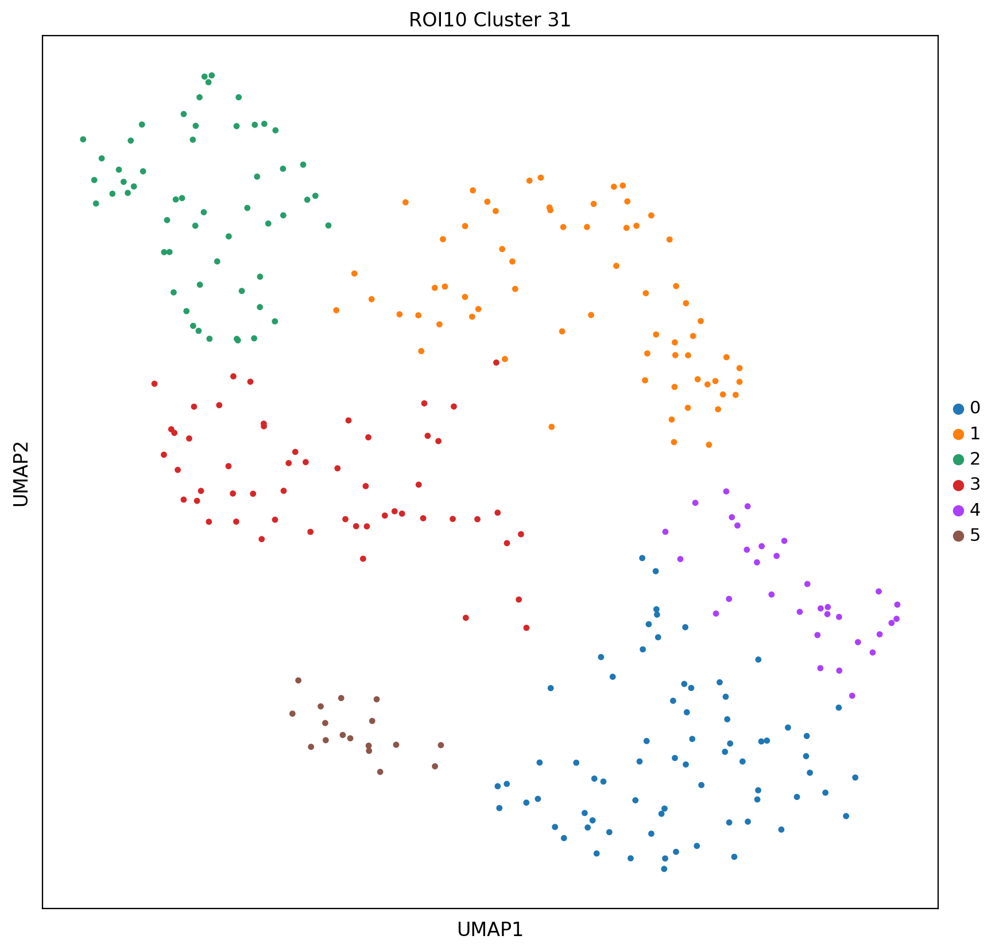

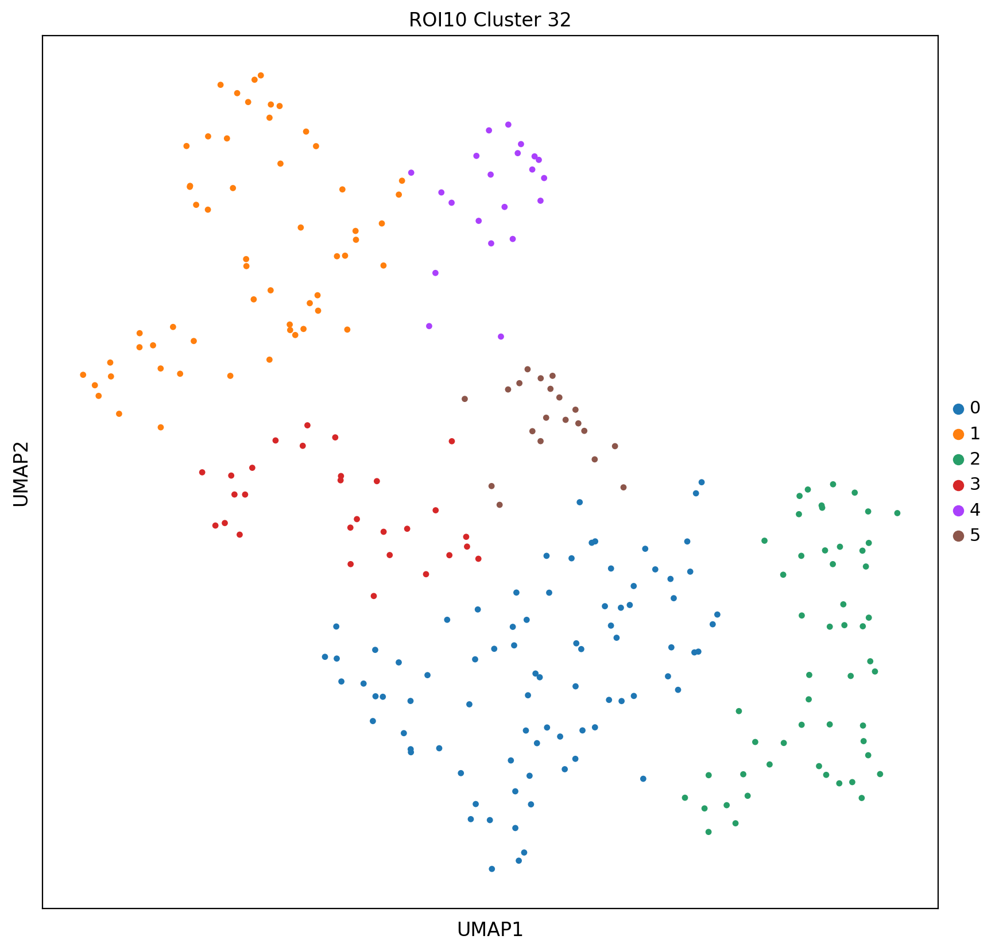

In [20]:
umap(cluster0, pc0, '0', 0.8)
#umap(cluster1, pc1, '1', 0.5)
umap(cluster2, pc2, '2', 0.5)
umap(cluster3, pc3, '3', 0.5)
umap(cluster4, pc4, '4', 0.7)
umap(cluster5, pc5, '5', 0.5)
umap(cluster6, pc6, '6', 0.9)
umap(cluster7, pc7, '7', 0.7)
#umap(cluster8, pc8, '8', 0.5)
umap(cluster9, pc9, '9', 0.5)
umap(cluster10, pc10, '10', 1.4)
#umap(cluster11, pc11, '11', 0.5)
#umap(cluster12, pc12, '12', 0.6)
#umap(cluster13, pc13, '13', 0.5)
#umap(cluster14, pc14, '14', 0.5)
#umap(cluster15, pc15, '15', 0.7)
#umap(cluster16, pc16, '16', 0.9)
#umap(cluster17, pc17, '17', 0.5)
#umap(cluster18, pc18, '18', 0.5)
#umap(cluster19, pc19, '19', 0.5)
#umap(cluster20, pc20, '20', 0.5)
umap(cluster21, pc21, '21', 0.5)
umap(cluster22, pc22, '22', 0.5)
umap(cluster23, pc23, '23', 0.5)
#umap(cluster25, pc25, '25', 0.5)
#umap(cluster30, pc30, '30', 0.5)
umap(cluster31, pc31, '31', 0.5)
umap(cluster32, pc32, '32', 0.5)

## Generate Heatmaps for Subcluster

In [21]:
# median per cluster for heatmap
def median_cluster(data, numOfCluster, cluster):
    cluster_count = 0
    cluster_df = pd.DataFrame(columns=data.columns.to_list())

    while cluster_count < numOfCluster:
        id_of_cluster = [key for key, val in cluster.items() if val == str(cluster_count)] # get all IDs of one cluster
        df_of_cluster = data.loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
        median_of_cluster = df_of_cluster.median().to_frame().T # compute the median per marker (column)
        cluster_df = pd.concat([cluster_df, median_of_cluster]) # merge the median results in a dataframe
        cluster_count += 1
    
    cluster_df = cluster_df.reset_index()
    cluster_df = cluster_df.drop('index', axis=1)

    return cluster_df

In [22]:
cluster0_data = median_cluster(cluster0.to_df(), 10, cluster0.obs['leiden'])
#cluster1_data  = median_cluster(cluster1.to_df(), 6, cluster1.obs['leiden'])
cluster2_data  = median_cluster(cluster2.to_df(), 6, cluster2.obs['leiden'])
cluster3_data  = median_cluster(cluster3.to_df(), 5, cluster3.obs['leiden'])
cluster4_data  = median_cluster(cluster4.to_df(), 8, cluster4.obs['leiden'])
cluster5_data  = median_cluster(cluster5.to_df(), 7, cluster5.obs['leiden'])
cluster6_data  = median_cluster(cluster6.to_df(), 10, cluster6.obs['leiden'])
cluster7_data  = median_cluster(cluster7.to_df(), 6, cluster7.obs['leiden'])
#cluster8_data  = median_cluster(cluster8.to_df(), 7, cluster8.obs['leiden'])
cluster9_data  = median_cluster(cluster9.to_df(), 6, cluster9.obs['leiden'])
cluster10_data  = median_cluster(cluster10.to_df(), 14, cluster10.obs['leiden'])
#cluster11_data  = median_cluster(cluster11.to_df(), 4, cluster11.obs['leiden'])
#cluster12_data  = median_cluster(cluster12.to_df(), 7, cluster12.obs['leiden'])
#cluster13_data  = median_cluster(cluster13.to_df(), 5, cluster13.obs['leiden'])
#cluster14_data  = median_cluster(cluster14.to_df(), 7, cluster14.obs['leiden'])
#cluster15_data  = median_cluster(cluster15.to_df(), 6, cluster15.obs['leiden'])
#cluster16_data  = median_cluster(cluster16.to_df(), 6, cluster16.obs['leiden'])
#cluster17_data  = median_cluster(cluster17.to_df(), 6, cluster17.obs['leiden'])
#cluster18_data  = median_cluster(cluster18.to_df(), 4, cluster18.obs['leiden'])
#cluster19_data  = median_cluster(cluster19.to_df(), 3, cluster19.obs['leiden'])
#cluster20_data  = median_cluster(cluster20.to_df(), 3, cluster20.obs['leiden'])
cluster21_data  = median_cluster(cluster21.to_df(), 6, cluster21.obs['leiden'])
cluster22_data  = median_cluster(cluster22.to_df(), 5, cluster22.obs['leiden'])
cluster23_data  = median_cluster(cluster23.to_df(), 6, cluster23.obs['leiden'])
#cluster25_data  = median_cluster(cluster25.to_df(), 3, cluster25.obs['leiden'])
#cluster30_data  = median_cluster(cluster30.to_df(), 4, cluster30.obs['leiden'])
cluster31_data  = median_cluster(cluster31.to_df(), 6, cluster31.obs['leiden'])
cluster32_data  = median_cluster(cluster32.to_df(), 6, cluster32.obs['leiden'])

In [23]:
sns.set(font_scale=0.8)
def plotHeatmap(data, subcluster):
    plot= sns.clustermap(data.T,
                         standard_scale=1,  # Either 0 (rows) or 1 (columns).
                         cmap='Reds', 
                         yticklabels=True, xticklabels=True,
                         figsize=(10, 10),
                         row_cluster=False,
                         col_cluster=True)
    plot.fig.suptitle(sample + ' Cluster ' + str(subcluster))
    plot = plt.savefig('results_subcluster_' + sample + '/matrixplot' + sample + '_' + str(subcluster) + '.pdf', dpi=150);

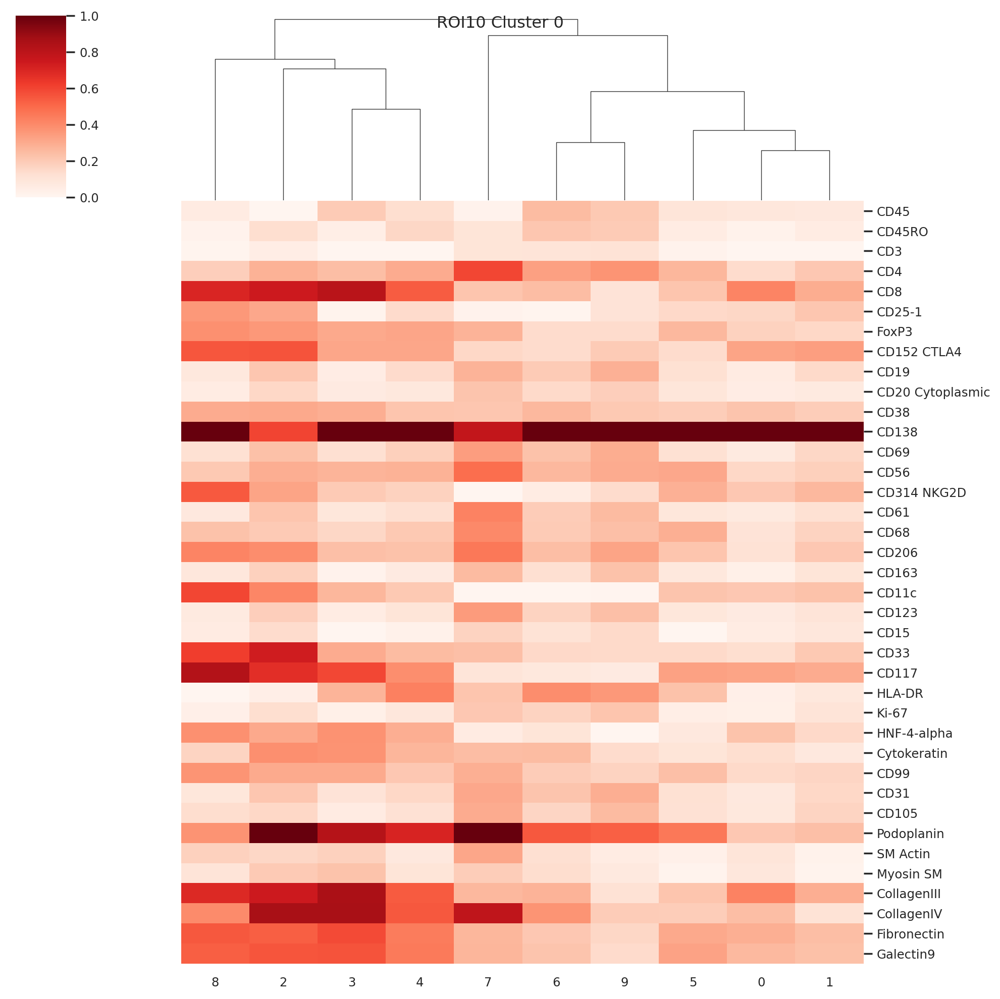

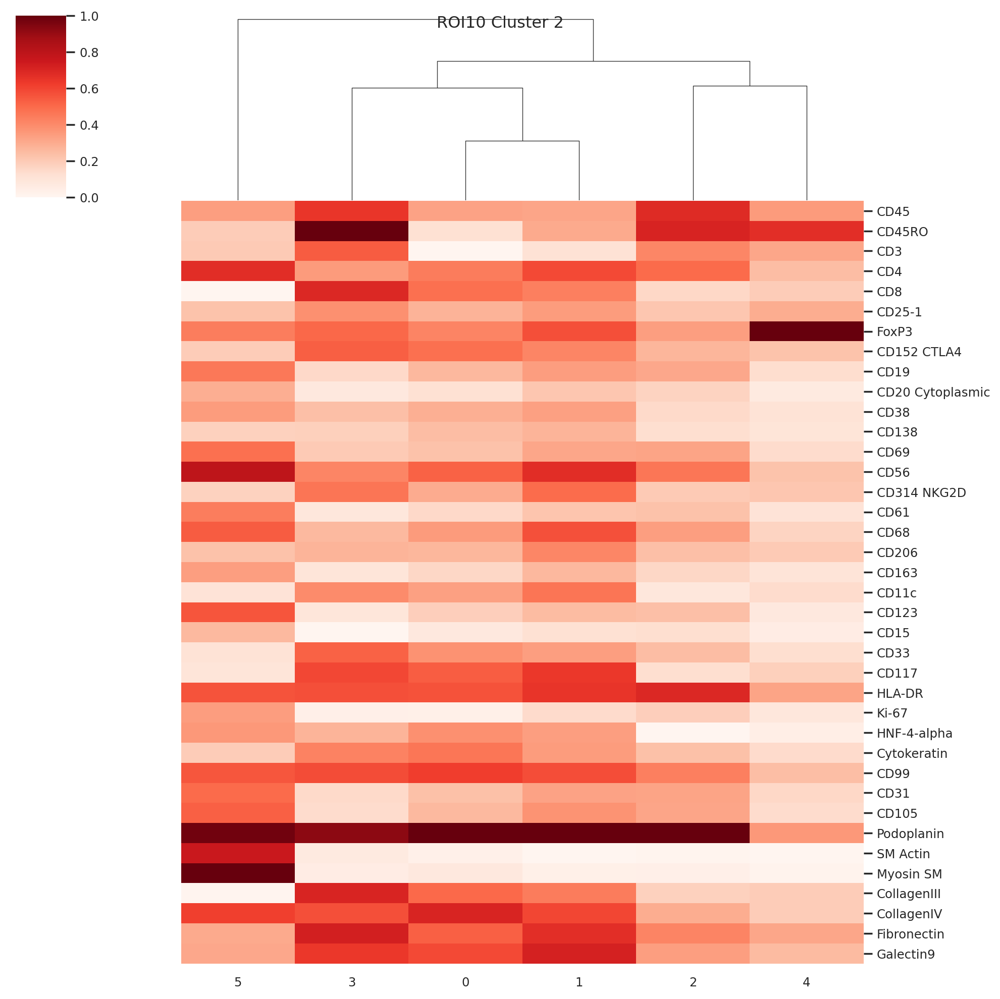

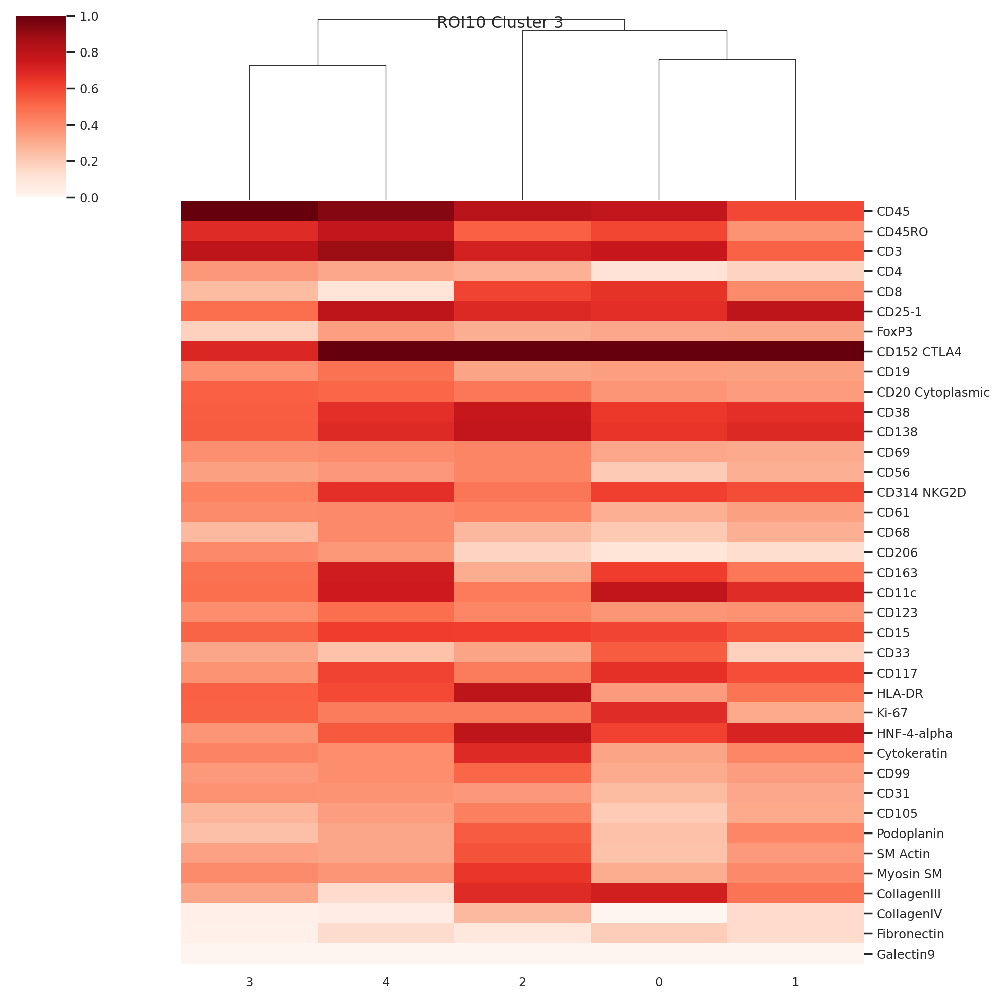

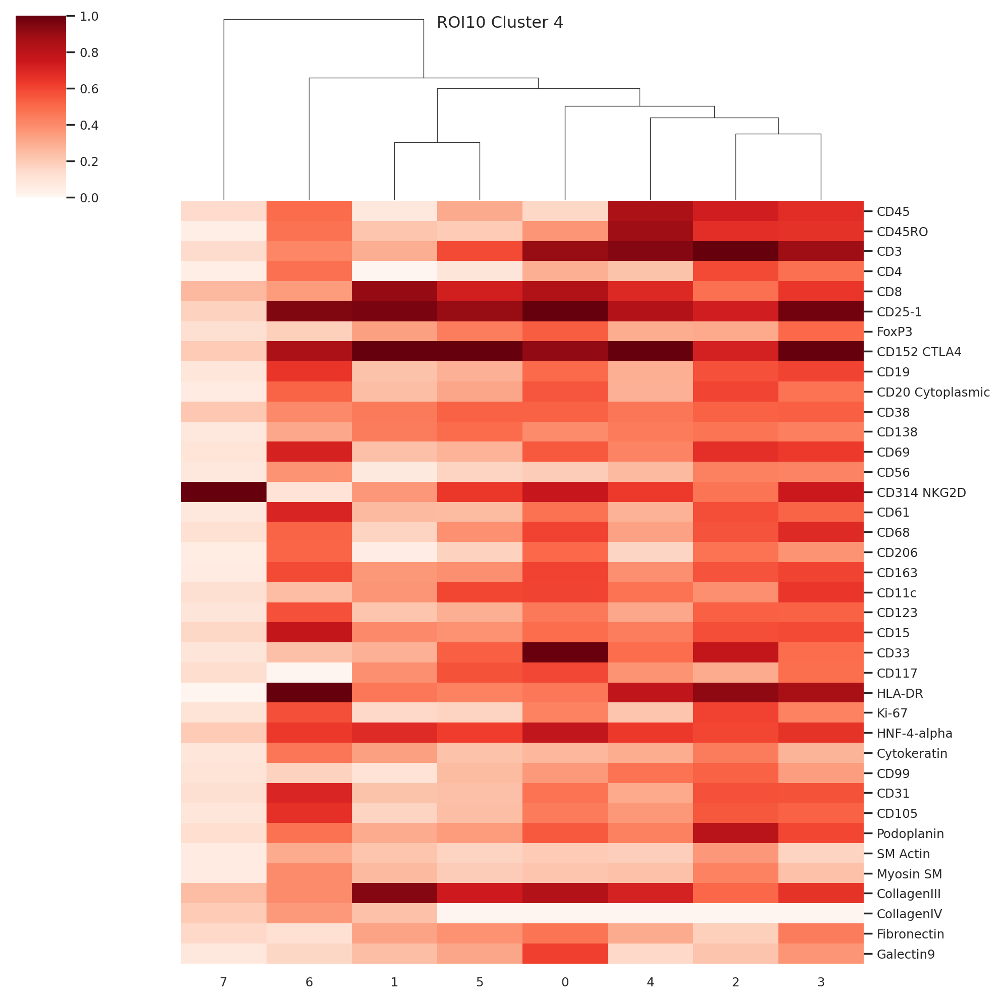

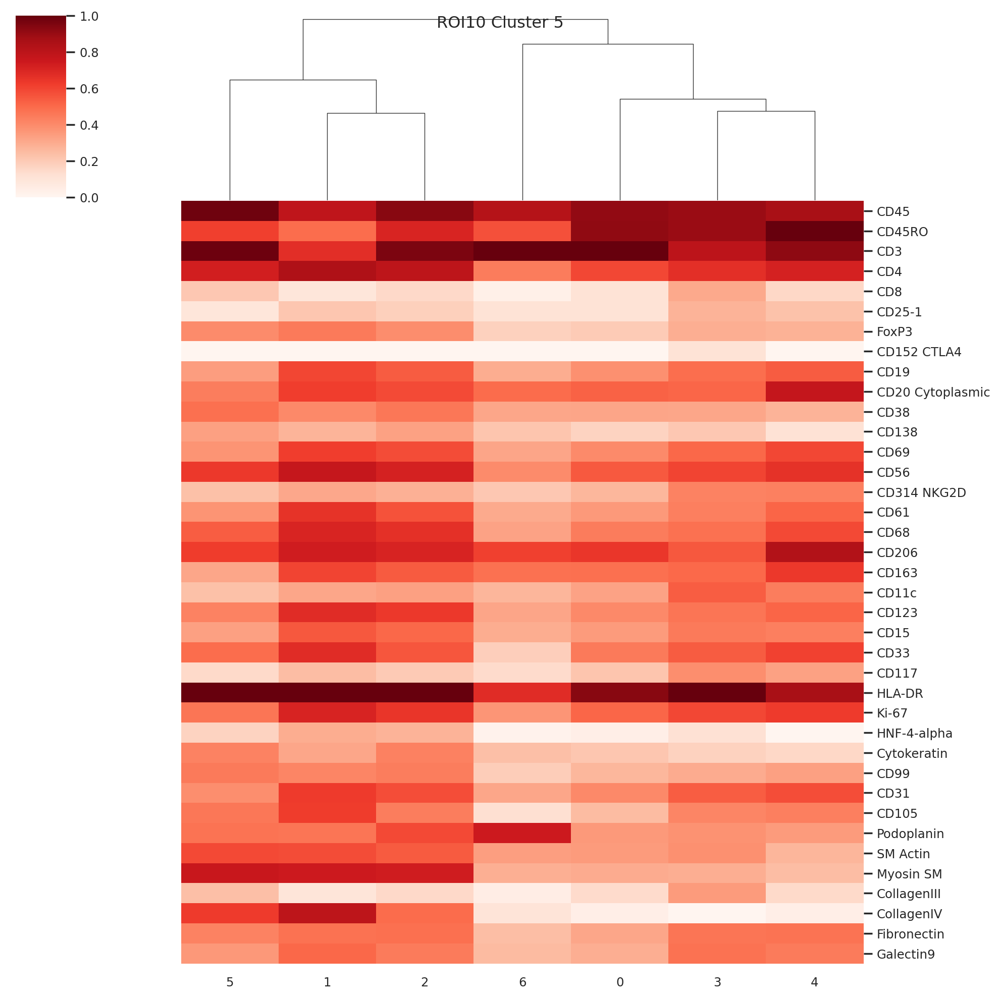

...

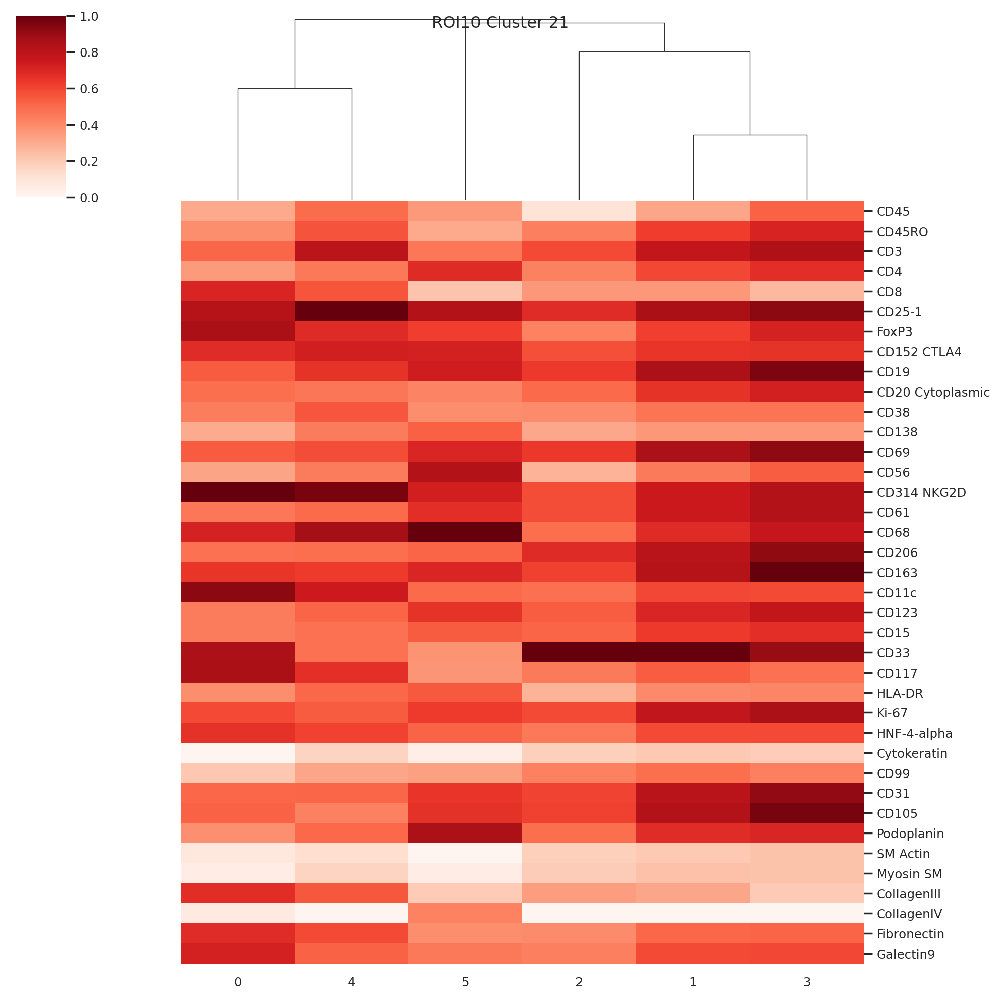

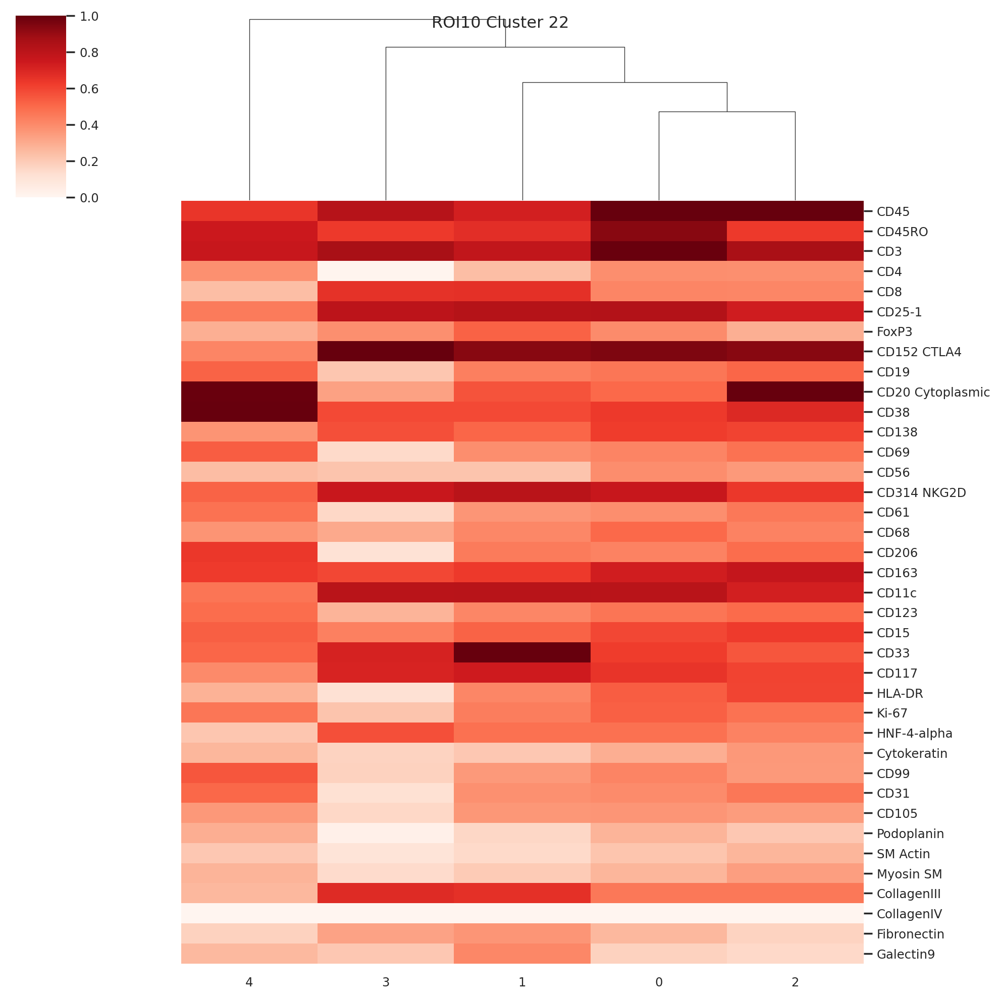

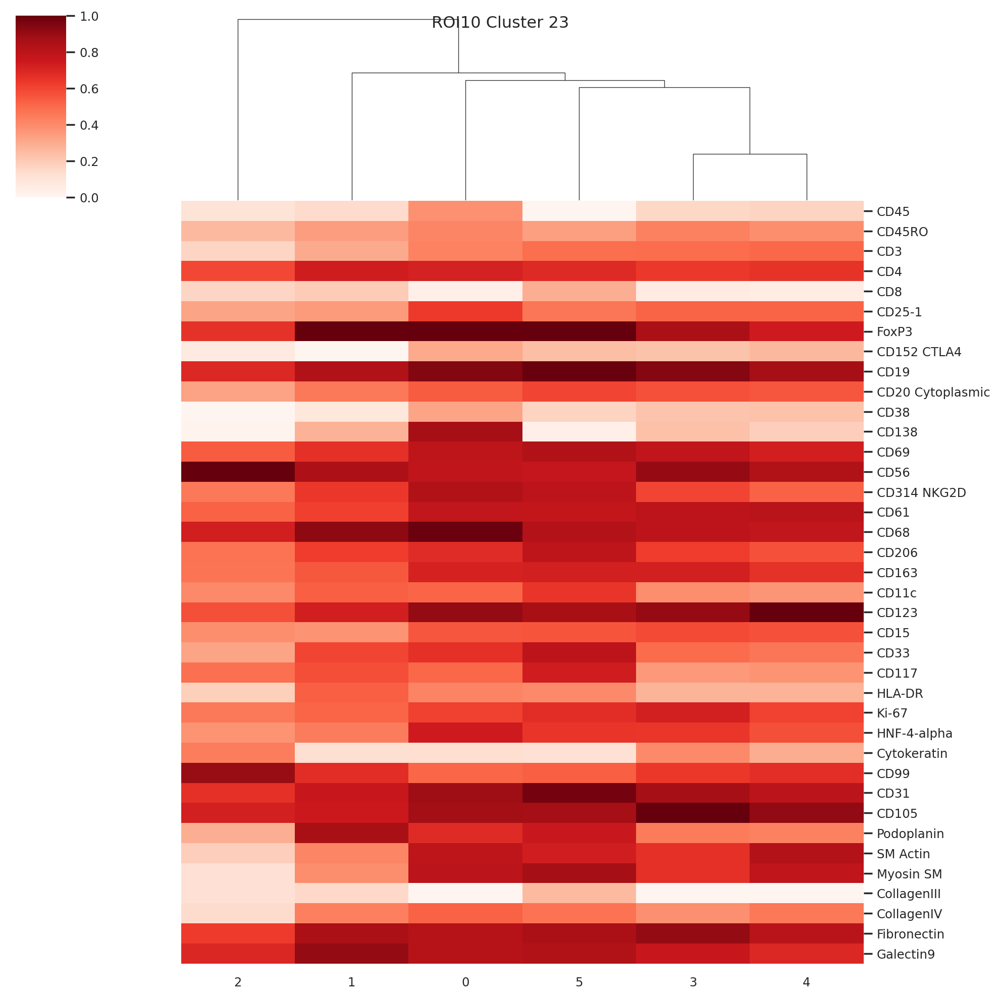

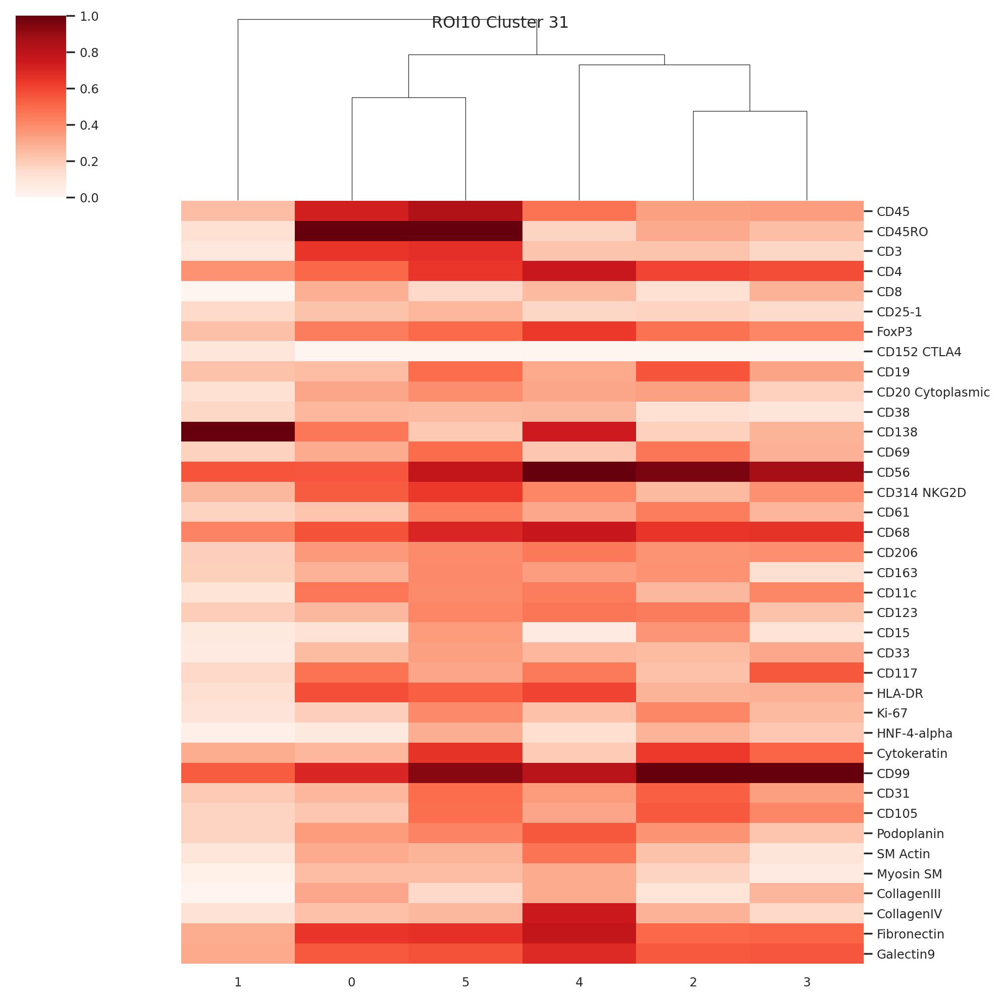

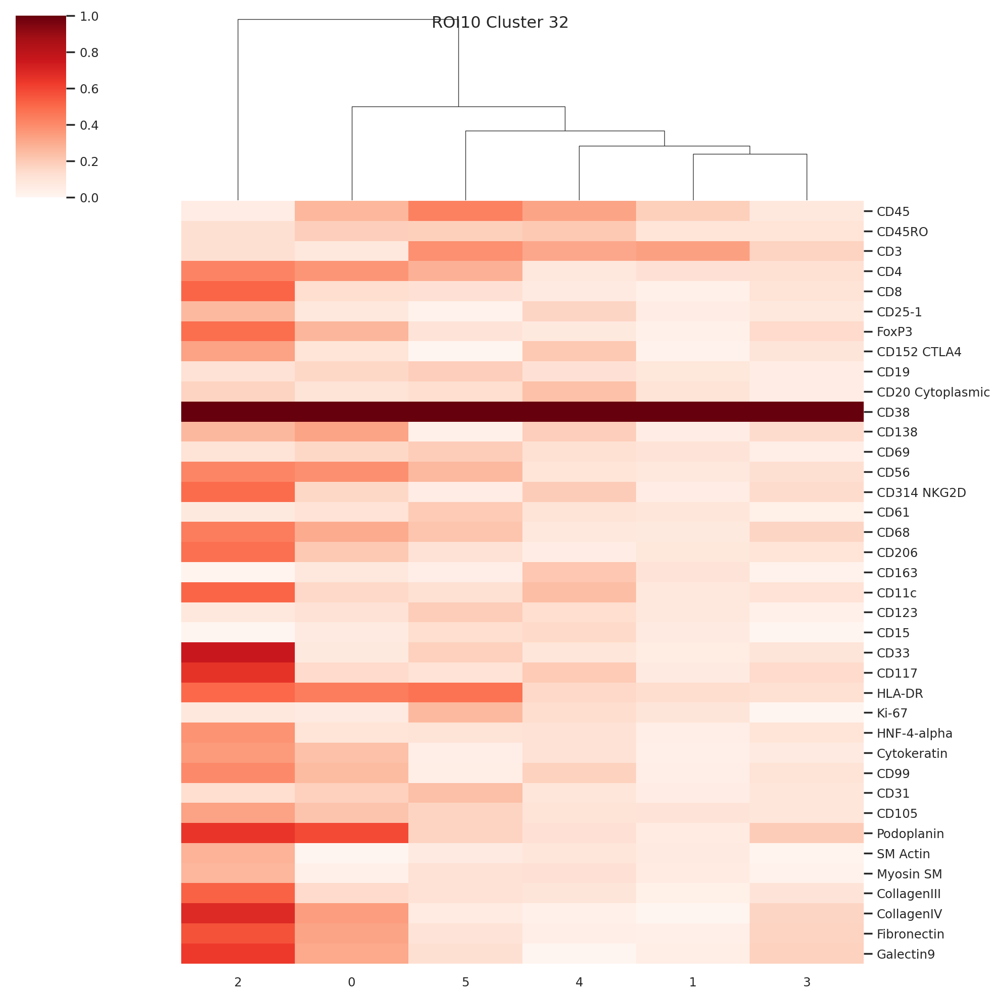

In [24]:
plotHeatmap(cluster0_data, 0 )
#plotHeatmap(cluster1_data, 1)
plotHeatmap(cluster2_data, 2)
plotHeatmap(cluster3_data, 3)
plotHeatmap(cluster4_data, 4)
plotHeatmap(cluster5_data, 5)
plotHeatmap(cluster6_data, 6)
plotHeatmap(cluster7_data, 7)
#plotHeatmap(cluster8_data, 8)
plotHeatmap(cluster9_data, 9)
plotHeatmap(cluster10_data, 10)
#plotHeatmap(cluster11_data, 11)
#plotHeatmap(cluster12_data, 12)
#plotHeatmap(cluster13_data, 13)
#plotHeatmap(cluster14_data, 14)
#plotHeatmap(cluster15_data, 15)
#plotHeatmap(cluster16_data, 16)
#plotHeatmap(cluster17_data, 17)
#plotHeatmap(cluster19_data, 19)
#plotHeatmap(cluster18_data, 18)
#plotHeatmap(cluster20_data, 20)
plotHeatmap(cluster21_data, 21)
plotHeatmap(cluster22_data, 22)
plotHeatmap(cluster23_data, 23)
#plotHeatmap(cluster25_data, 25)
#plotHeatmap(cluster30_data, 30)
plotHeatmap(cluster31_data, 31)
plotHeatmap(cluster32_data, 32)

In [25]:
def countsPerCluster(data):
    ser_counts = data.obs['leiden'].value_counts()
    ser_counts.name = 'cell counts'
    meta_leiden = pd.DataFrame(ser_counts)
    return meta_leiden

In [26]:
cellCounts = countsPerCluster(cluster32)

In [27]:
cellCounts['cell counts'].to_list()

[83, 57, 52, 29, 21, 20]

# Assigne new Subcluster to ROI

In [28]:
def listOfSubcluster(current_subcluster, clusterNum, index):
    newList = []
    for idx in range(len(current_subcluster)):
        newEntry = clusterNum + '.' + current_subcluster[idx]
        newList.append(newEntry)
    newdf = pd.DataFrame(data = newList, index = index)
    return newdf

In [29]:
# new Subcluster Lists
df0 = listOfSubcluster(cluster0.obs['leiden'].to_list(), '0', cluster0.obs['leiden'].index)
#df1 = listOfSubcluster(cluster1.obs['leiden'].to_list(), '1', cluster1.obs['leiden'].index)
df2 = listOfSubcluster(cluster2.obs['leiden'].to_list(), '2', cluster2.obs['leiden'].index)
df3 = listOfSubcluster(cluster3.obs['leiden'].to_list(), '3', cluster3.obs['leiden'].index)
df4 = listOfSubcluster(cluster4.obs['leiden'].to_list(), '4', cluster4.obs['leiden'].index)
df5 = listOfSubcluster(cluster5.obs['leiden'].to_list(), '5', cluster5.obs['leiden'].index)
df6 = listOfSubcluster(cluster6.obs['leiden'].to_list(), '6', cluster6.obs['leiden'].index)
df7 = listOfSubcluster(cluster7.obs['leiden'].to_list(), '7', cluster7.obs['leiden'].index)
df9 = listOfSubcluster(cluster9.obs['leiden'].to_list(), '9', cluster9.obs['leiden'].index)
#df10 = listOfSubcluster(cluster10.obs['leiden'].to_list(), '10', cluster10.obs['leiden'].index)
#df11 = listOfSubcluster(cluster11.obs['leiden'].to_list(), '11', cluster11.obs['leiden'].index)
#df12 = listOfSubcluster(cluster12.obs['leiden'].to_list(), '12', cluster12.obs['leiden'].index)
#df14 = listOfSubcluster(cluster14.obs['leiden'].to_list(), '14', cluster14.obs['leiden'].index)
#df18 = listOfSubcluster(cluster18.obs['leiden'].to_list(), '18', cluster18.obs['leiden'].index)
df21 = listOfSubcluster(cluster21.obs['leiden'].to_list(), '21', cluster21.obs['leiden'].index)
df22 = listOfSubcluster(cluster22.obs['leiden'].to_list(), '22', cluster22.obs['leiden'].index)
df23 = listOfSubcluster(cluster23.obs['leiden'].to_list(), '23', cluster23.obs['leiden'].index)
df31 = listOfSubcluster(cluster31.obs['leiden'].to_list(), '31', cluster31.obs['leiden'].index)
df32 = listOfSubcluster(cluster32.obs['leiden'].to_list(), '32', cluster32.obs['leiden'].index)

In [30]:
def oldCluster(clusterNum):
    id_of_cluster = [key for key, val in adata.obs['leiden'].items() if val == str(clusterNum)]
    df = pd.DataFrame(data = ([str(clusterNum)] * len(id_of_cluster)), index = id_of_cluster)
    return df

In [31]:
#df0 = oldCluster(0)
df1 = oldCluster(1)
#df2 = oldCluster(2)
#df3 = oldCluster(3)
#df4 = oldCluster(4)
#df5 = oldCluster(5)
#df6 = oldCluster(6)
#df7 = oldCluster(7)
df8 = oldCluster(8)
#df9 = oldCluster(9)
df10 = oldCluster(10)
df11 = oldCluster(11)
df12 = oldCluster(12)
df13 = oldCluster(13)
df14 = oldCluster(14)
df15 = oldCluster(15)
df16 = oldCluster(16)
df17 = oldCluster(17)
df18 = oldCluster(18)
df19 = oldCluster(19)
df20 = oldCluster(20)
#df21 = oldCluster(21)
#df22 = oldCluster(22)
#df23 = oldCluster(23)
df24 = oldCluster(24)
df25 = oldCluster(25)
df26 = oldCluster(26)
df27 = oldCluster(27)
df28 = oldCluster(28)
df29 = oldCluster(29)
df30 = oldCluster(30)
#df31 = oldCluster(31)
#df32 = oldCluster(32)
df33 = oldCluster(33)
df34 = oldCluster(34)
df35 = oldCluster(35)
df36 = oldCluster(36)
df37 = oldCluster(37)
df38 = oldCluster(38)
df39 = oldCluster(39)
df40 = oldCluster(40)
df41 = oldCluster(41)
df42 = oldCluster(42)
df43 = oldCluster(43)

In [32]:
newCLuster = pd.concat([df0, df1, df2, df3, df4, df5, df6, df7, df8, df9, df10, df11, df12, df13, df14, df15, df16, df17, df18, df19, df20, df21, df22,
                       df23, df24, df25, df26, df27, df28, df29, df30, df31, df32, df33, df34, df35, df36, df37, df38, df39, df40, df41, df42, df43])

In [33]:
adata.obs['subLeiden'] = newCLuster

# Heatmap with new subcluster

In [34]:
# median per cluster for heatmap
def median_clusterAll(data, numOfCluster, cluster):
    cluster_count = 0
    cluster_df = pd.DataFrame(columns=data.columns.to_list())

    while cluster_count < numOfCluster:
        id_of_cluster = [key for key, val in cluster.items() if val == str(cluster_count)] # get all IDs of one cluster
        df_of_cluster = data.loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
        median_of_cluster = df_of_cluster.median().to_frame().T # compute the median per marker (column)
        cluster_df = pd.concat([cluster_df, median_of_cluster]) # merge the median results in a dataframe
        cluster_count += 1
    
    cluster_df = cluster_df.reset_index()
    cluster_df = cluster_df.drop('index', axis=1)

    return cluster_df

In [35]:
cluster_df = median_clusterAll(adata.to_df(), 41, adata.obs['subLeiden']) # compute median per subcluster
cluster_df= cluster_df.drop([0, 2, 3, 4, 5, 6, 7, 9, 21, 22, 23, 31, 32], axis=0) # drop old/original cluster

In [36]:
idx0 = np.unique(df0[0].to_list())

In [37]:
def newIdx(df, data):
    idx0 = np.unique(df[0].to_list())
    data['idx'] = idx0
    data = data.set_index('idx')
    return data

In [38]:
cluster0_data

,CD45,CD45RO,CD3,CD4,CD8,CD25-1,FoxP3,CD152 CTLA4,CD19,CD20 Cytoplasmic,...,CD99,CD31,CD105,Podoplanin,SM Actin,Myosin SM,CollagenIII,CollagenIV,Fibronectin,Galectin9
0,-0.589292,-0.829465,-0.917327,-0.371195,0.746188,-0.297273,-0.229511,0.357737,-0.677144,-0.709104,...,-0.334947,-0.622071,-0.595322,-0.087559,-0.544510,-0.584455,0.754614,0.027504,0.216903,0.091016
1,-0.179436,-0.253485,-0.479210,0.346515,0.703300,0.375602,0.135360,0.865710,0.110558,-0.203985,...,0.162006,0.140692,0.182135,0.456400,-0.396409,-0.426231,0.683018,-0.037719,0.476964,0.452397
2,-0.921239,-0.641045,-0.814395,-0.327878,0.653535,-0.264163,-0.165226,0.269026,-0.473814,-0.595946,...,-0.277788,-0.472390,-0.596098,1.195939,-0.590395,-0.493827,0.655280,0.903947,0.196448,0.259789
3,-0.569632,-0.844497,-0.918378,-0.490988,0.523650,-0.902511,-0.376884,-0.361652,-0.830486,-0.811095,...,-0.384750,-0.729321,-0.813654,0.551910,-0.606076,-0.520928,0.602322,0.616181,0.121269,0.077387
4,-0.384256,-0.316394,-0.697644,0.023149,0.598371,-0.347984,0.069674,0.065743,-0.355000,-0.502234,...,-0.187418,-0.322631,-0.407891,1.021355,-0.510854,-0.457787,0.616786,0.631546,0.375923,0.395261
5,0.118780,-0.030317,-0.178917,0.757886,0.574413,0.326393,0.741584,0.278575,0.214577,0.092876,...,0.649269,0.214932,0.202532,1.486992,-0.145238,-0.195144,0.578252,0.471581,0.925568,0.993759
6,-0.032938,-0.176634,-0.608391,0.293269,-0.046748,-0.965073,-0.466559,-0.471587,-0.242702,-0.438976,...,-0.249006,-0.150069,-0.374417,1.140774,-0.507905,-0.479492,0.069018,0.439200,-0.184661,-0.143458
7,-0.595242,-0.412623,-0.419628,0.696123,-0.149842,-0.602167,-0.018233,-0.294604,-0.024252,-0.143406,...,0.007349,0.061012,0.033863,1.601402,0.061447,-0.216639,-0.057214,1.122020,-0.050446,-0.040691
8,-0.521313,-0.619210,-0.638575,-0.234880,0.961274,0.159339,0.216157,0.612375,-0.480904,-0.531057,...,0.189903,-0.462800,-0.354943,0.200512,-0.254051,-0.424312,0.933418,0.250860,0.609352,0.564069
9,0.237595,0.202982,-0.169482,0.972475,-0.184616,-0.179934,-0.046530,0.217014,0.586673,0.164583,...,0.092244,0.633951,0.449210,1.661381,-0.410075,-0.350422,-0.159931,0.201599,0.031954,-0.028287


In [39]:
df0

,0
ID,
136,0.1
1304,0.1
2950,0.1
3058,0.1
3419,0.1
...,...
17209,0.5
17222,0.5
17223,0.6


In [40]:
# reindex the data, so that the subcluster have the correct index
df0 = newIdx(df0, cluster0_data)
df2 = newIdx(df2, cluster2_data)
df3 = newIdx(df3, cluster3_data)
df4 = newIdx(df4, cluster4_data)
df5 = newIdx(df5, cluster5_data)
df6 = newIdx(df6, cluster6_data)
df7 = newIdx(df7, cluster7_data)
df9 = newIdx(df9, cluster9_data)
df21 = newIdx(df21, cluster21_data)
df22 = newIdx(df22, cluster22_data)
df23 = newIdx(df23, cluster23_data)
df31 = newIdx(df31, cluster31_data)
df32 = newIdx(df32, cluster32_data)

In [41]:
# add the new subcluster to the dataframe
dataAll = cluster_df.append([df0, df2, df3, df4, df5, df6, df7, df9, df21, df22, df23, df31, df32])

In [42]:
sns.set(font_scale=1)
def plotHeatmapAll(data, name):
    plot= sns.clustermap(data.T,
                         standard_scale=1,  # Either 0 (rows) or 1 (columns).
                         cmap='Reds', 
                         yticklabels=True, xticklabels=True,
                         figsize=(19, 20),
                         row_cluster=True,
                         col_cluster=True,
                         dendrogram_ratio=0.1)

    plt.setp(plot.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
    plt.setp(plot.ax_heatmap.xaxis.get_majorticklabels(), rotation=35, ha='right', rotation_mode='anchor')
    plt.subplots_adjust(top=0.98) # space between title and plot
    plot.fig.suptitle('Cell Type Annotation ' + name,  y=1, fontsize=30) 
    plot.fig.subplots_adjust(right=0.7)
    plot.ax_cbar.set_position((0.89, .28, .015, .4))
    plot = plt.savefig('results_subcluster_' + sample + '/Newmatrixplot' + sample + '.pdf', dpi=250, bbox_inches='tight');

In [43]:
sc.settings.set_figure_params(dpi=220, fontsize=5, dpi_save=700, figsize=(15,15))
plotHeatmapAll(dataAll, sample)

# Annotate

In [44]:
cellTypes=[
#'0' : '0', 
'Tumour cells', 
#'2' : '2', 
#'3' : '3', #'T cells (act/reg)', 
#'4' : '?',  
#'5' : ''Dendritic cells', 
#'6' : 'B cells6', 
#'7' : 'Immune cells', #'T cells (act/reg)', 
'Tumour cells', 
#'9' : 'CAF9', 
'Collagen',  
'Collagen',  
'Collagen', 
'Collagen', 
'Collagen', 
'Collagen', 
'Fibroblasts', 
'Collagen', 
'Fibroblasts', 
'Fibroblasts', 
'Collagen', 
#'21' : 'Granulocyte21', 
#'22' : 'T cells (act/reg)', 
#'23' : '23', 
'Collagen', 
'Tumour cells', 
'Collagen', 
'Collagen', 
'Collagen', 
'Collagen', 
'Collagen', 
#'31' : 'Tumour cells/ NK cells ', 
#'32' : 'Plasma cells32', 
'Fibroblasts', 
'Fibroblasts', 
'Fibroblasts', 
'Fibroblasts', 
'Tumour cells', 
'Tumour cells', 
'Tumour cells', 
'Unknown', 
   
# 0
'Collagen',
'Collagen',
'Lymphatic Vessels ',
'Collagen',
'Lymphatic Vessels ',
'Lymphatic Vessels ',
'Lymphatic Vessels ',
'Lymphatic Vessels ',
'Collagen',
'Lymphatic Vessels ',
  
# 2
'Lymphatic Vessels ',
'Lymphatic Vessels ',
'Dendritic cells', 
'CD8+ T cells',
'Regulatory T cells',
'Lymphatic Vessels ',

# 3
'CD8+ T cells',
'CD8+ T cells',
'CD8+ T cells',
'Effector T cells',
'Effector T cells',
  
# 4 
'CD8+ T cells',
'Collagen',
'CD8+ T cells',
'CD8+ T cells',
'CD8+ T cells',
'CD8+ T cells',
'CD8+ T cells',
'Collagen',
    
# 5
'Dendritic cells', 
'Dendritic cells', 
'Dendritic cells', 
'Dendritic cells', 
'Dendritic cells', 
'Dendritic cells', 
'Dendritic cells', 
    
# 6
'B cells',
'B cells',
'Collagen',
'B cells',
'B cells',
'B cells',
'B cells',
'B cells',
'B cells',
'B cells',
  
# 7
'CD8+ T cells',
'Effector T cells',
'Effector T cells',
'Activated T cells',
'Activated T cells',
'Activated T cells',

# 9
'CAF',
'CAF',
'CAF',
'CAF',
'Tumour cells',
'Activated B cells',

# 21
'Collagen',
'Granulocyte',
'Granulocyte',
'Granulocyte',
'M1 Macrophages',
'M1 Macrophages',

# 22
'Effector T cells',
'CD8+ T cells',
'Effector T cells',
'CD8+ T cells',
'CD8+ T cells',

# 23
'CAF',
'Tumour cells',
'Endothelial',
'Endothelial',
'Endothelial',
'Endothelial',

# 31
'NK cells ',
'Plasma cells',
'Tumour cells',
'Tumour cells',
'Tumour cells',
'NK cells ',

# 32
'Plasma cells',
'Plasma cells',
'Collagen',
'Plasma cells',
'Plasma cells',
'Dendritic cells', 
]

In [45]:
dataAll.index = cellTypes

In [46]:
plotHeatmapAll(dataAll,  'Annotated')

# Merge

In [47]:
annotated_merged_data = dataAll.groupby(level=0).mean()

In [48]:
sc.settings.set_figure_params(dpi=220, fontsize=30, dpi_save=700)
plotHeatmapAll(annotated_merged_data, sample)

# Annotated UMAP

In [49]:
old_to_new = {
#'0' : '0', 
'1' : 'Tumour cells', 
#'2' : '2', 
#'3' : '3', #'T cells (act/reg)', 
#'4' : '?',  
#'5' : 'Dendritic cells', 
#'6' : 'B cells6', 
#'7' : 'Immune cells', #'T cells (act/reg)', 
'8' : 'Tumour cells', 
#'9' : 'CAF9', 
'10' : 'Collagen',  
'11' : 'Collagen',  
'12' : 'Collagen', 
'13' : 'Collagen', 
'14' : 'Collagen', 
'15' : 'Collagen', 
'16' : 'Fibroblasts', 
'17' : 'Collagen', 
'18' : 'Fibroblasts', 
'19' : 'Fibroblasts', 
'20' : 'Collagen', 
#'21' : 'Granulocyte21', 
#'22' : 'T cells (act/reg)', 
#'23' : '23', 
'24' : 'Collagen', 
'25' : 'Tumour cells', 
'26' : 'Collagen', 
'27' : 'Collagen', 
'28' : 'Collagen', 
'29' : 'Collagen', 
'30' : 'Collagen', 
#'31' : 'Tumour cells/ NK cells ', 
#'32' : 'Plasma cells32', 
'33' : 'Fibroblasts', 
'34' : 'Fibroblasts', 
'35' : 'Fibroblasts', 
'36' : 'Fibroblasts', 
'37' : 'Tumour cells', 
'38' : 'Tumour cells', 
'39' : 'Tumour cells', 
'40' : 'Unknown', 
    
'0.0' : 'Collagen',
'0.1' : 'Collagen',
'0.2' : 'Lymphatic Vessels ',
'0.3' : 'Collagen',
'0.4' : 'Lymphatic Vessels ',
'0.5' : 'Lymphatic Vessels ',
'0.6' : 'Lymphatic Vessels ',
'0.7' : 'Lymphatic Vessels ',
'0.8' : 'Collagen',
'0.9' : 'Lymphatic Vessels ',
    
'2.0' : 'Lymphatic Vessels ',
'2.1' : 'Lymphatic Vessels ',
'2.2' : 'Dendritic cells', 
'2.3' : 'CD8+ T cells',
'2.4' : 'Regulatory T cells',
'2.5' : 'Lymphatic Vessels ',
    
'3.0' : 'CD8+ T cells',
'3.1' : 'CD8+ T cells',
'3.2' : 'CD8+ T cells',
'3.3' : 'Effector T cells',
'3.4' : 'Effector T cells',
    
'4.0' : 'CD8+ T cells',
'4.1' : 'Collagen',
'4.2' : 'CD8+ T cells',
'4.3' : 'CD8+ T cells',
'4.4' : 'CD8+ T cells',
'4.5' : 'CD8+ T cells',
'4.6' : 'CD8+ T cells',
'4.7' : 'Collagen',
    
'5.0' : 'Dendritic cells', 
'5.1' : 'Dendritic cells', 
'5.2' : 'Dendritic cells', 
'5.3' : 'Dendritic cells', 
'5.4' : 'Dendritic cells', 
'5.5' : 'Dendritic cells', 
'5.6' : 'Dendritic cells', 
    
'6.0' : 'B cells',
'6.1' : 'B cells',
'6.2' : 'Collagen',
'6.3' : 'B cells',
'6.4' : 'B cells',
'6.5' : 'B cells',
'6.6' : 'B cells',
'6.7' : 'B cells',
'6.8' : 'B cells',
'6.9' : 'B cells',
    
'7.0' : 'CD8+ T cells',
'7.1' : 'Effector T cells',
'7.2' : 'Effector T cells',
'7.3' : 'Activated T cells',
'7.4' : 'Activated T cells',
'7.5' : 'Activated T cells',
    
'9.0' : 'CAF',
'9.1' : 'CAF',
'9.2' : 'CAF',
'9.3' : 'CAF',
'9.4' : 'Tumour cells',
'9.5' : 'Activated B cells',

'21.0' : 'Collagen',
'21.1' : 'Granulocyte',
'21.2' : 'Granulocyte',
'21.3' : 'Granulocyte',
'21.4' : 'M1 Macrophages',
'21.5' : 'M1 Macrophages',

'22.0' : 'Effector T cells',
'22.1' : 'CD8+ T cells',
'22.2' : 'Effector T cells',
'22.3' : 'CD8+ T cells',
'22.4' : 'CD8+ T cells',
    
'23.0' : 'CAF',
'23.1' : 'Tumour cells',
'23.2' : 'Endothelial',
'23.3' : 'Endothelial',
'23.4' : 'Endothelial',
'23.5' : 'Endothelial',

'31.0' : 'NK cells ',
'31.1' : 'Plasma cells',
'31.2' : 'Tumour cells',
'31.3' : 'Tumour cells',
'31.4' : 'Tumour cells',
'31.5' : 'NK cells ',
    
'32.0' : 'Plasma cells',
'32.1' : 'Plasma cells',
'32.2' : 'Collagen',
'32.3' : 'Plasma cells',
'32.4' : 'Plasma cells',
'32.5' : 'Dendritic cells', 
}
adata.obs['annotation'] = (adata.obs['subLeiden'].map(old_to_new).astype('category'))

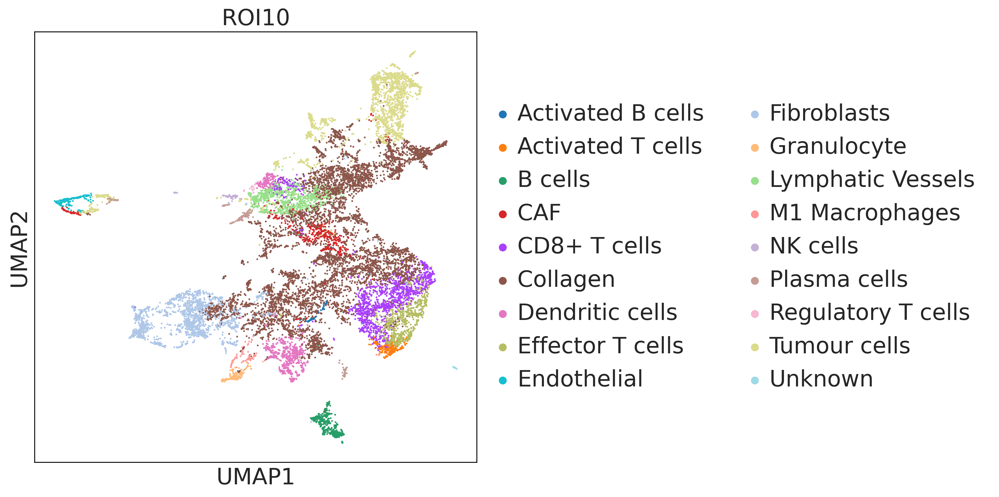

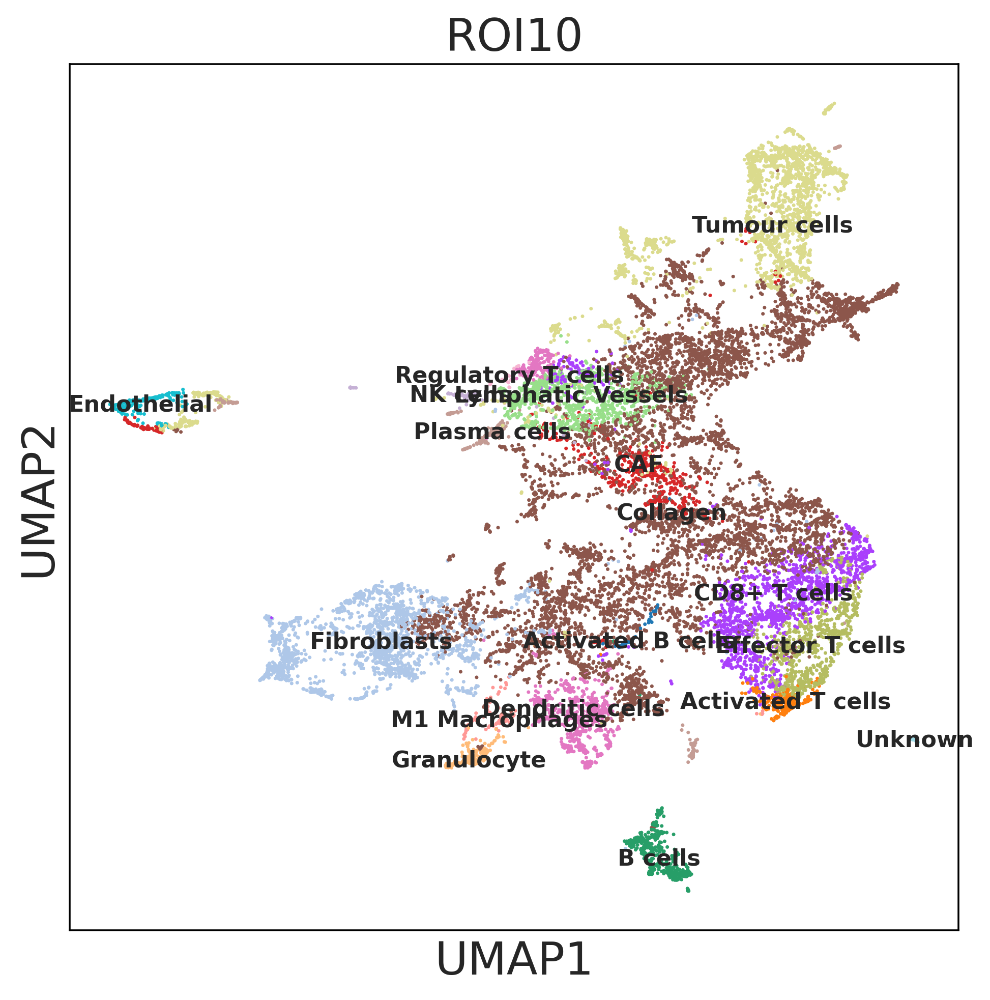

In [50]:
sc.settings.set_figure_params(dpi=160, fontsize=20, dpi_save=300, figsize=(7,7))
sc.pl.umap(adata, color=['annotation'], s=10, use_raw=False,  legend_fontsize=20, title = sample, save = sample + '.pdf', color_map='coolwarm', vcenter=0)
sc.pl.umap(adata, color=['annotation'], s=10, use_raw=False, legend_fontsize=10,  title = sample, legend_loc='on data', save = sample + '_logOnData.pdf', color_map='coolwarm', vcenter=0)

In [51]:
selced_marker = [
'CD45',  
'CD45RO',   
'CD3',
# CD2,
'CD4',
'CD8',    
'CD25-1',     
'FoxP3',
'CD152 CTLA4',   
#PD-L1
'CD19',     
'CD20 Cytoplasmic',
'CD38',     
'CD138', 
'CD69',    
'CD56',    
'CD314 NKG2D',     
'CD61',
'CD68', 
'CD206',     
'CD163',# IN ROI19 on Tumour cells       
'CD11c', 
'CD123',
'CD15',    
'CD33',  
'CD117',   
'HLA-DR',
'Ki-67',     
'HNF-4-alpha',  
'Cytokeratin',    
'CD99',
'CD31',    
'CD105',    
'Podoplanin',
'SM Actin',
'Myosin SM',
'CollagenIII',
'CollagenIV',
'Fibronectin',
'Galectin9',    
]

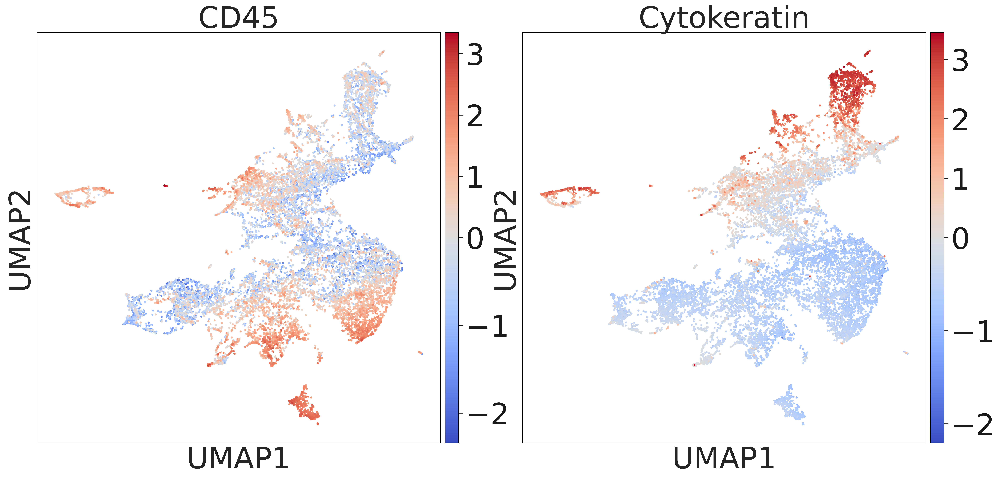

In [52]:
sc.settings.set_figure_params(dpi=220, fontsize=40, dpi_save=700, figsize=(10,10))
sc.pl.umap(adata, color=['CD45', 'Cytokeratin'], s=30, use_raw=False,  legend_fontsize=12, color_map='coolwarm', vcenter=0, save = sample + '_Expression.pdf',)

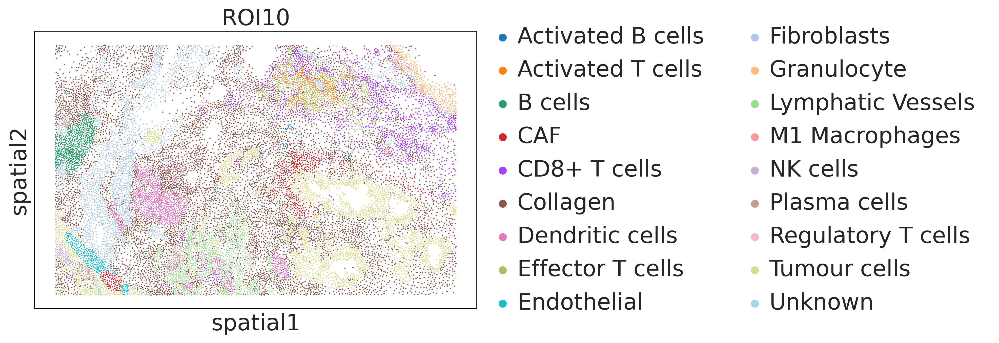

In [59]:
sc.settings.set_figure_params(dpi=160, fontsize=20, dpi_save=300, figsize=(7,7))
sc.pl.spatial(adata, color="annotation", spot_size=40, scale_factor=1, legend_fontsize=20, save = '_Spatial' + sample + '.pdf', title = sample)

In [54]:
types = adata.obs['annotation']
types

ID
1                  Collagen
2                  Collagen
3                  Collagen
4              Plasma cells
5                  Collagen
                ...        
17245    Lymphatic Vessels 
17246              Collagen
17247           Fibroblasts
17248              Collagen
17249          Tumour cells
Name: annotation, Length: 17249, dtype: category
Categories (18, object): ['Activated B cells', 'Activated T cells', 'B cells', 'CAF', ..., 'Plasma cells', 'Regulatory T cells', 'Tumour cells', 'Unknown']

In [55]:
unique_types = types.unique()
unique_types

['Collagen', 'Plasma cells', 'Fibroblasts', 'CD8+ T cells', 'Granulocyte', ..., 'B cells', 'Unknown', 'Lymphatic Vessels ', 'NK cells ', 'Endothelial']
Length: 18
Categories (18, object): ['Activated B cells', 'Activated T cells', 'B cells', 'CAF', ..., 'Plasma cells', 'Regulatory T cells', 'Tumour cells', 'Unknown']

In [56]:
types.count()

17249

In [57]:
dict_types = types.to_dict()

In [58]:
from collections import Counter
count = Counter(dict_types.values())
print(count)

Counter({'Collagen': 6774, 'Tumour cells': 2271, 'Fibroblasts': 1839, 'CD8+ T cells': 1535, 'Lymphatic Vessels ': 979, 'Dendritic cells': 887, 'Effector T cells': 680, 'CAF': 535, 'B cells': 527, 'Plasma cells': 255, 'Endothelial': 225, 'Activated T cells': 221, 'Granulocyte': 219, 'M1 Macrophages': 105, 'NK cells ': 87, 'Activated B cells': 52, 'Unknown': 30, 'Regulatory T cells': 28})
